In [15]:
# Cell 1: Setup and Imports
import os, sys
from pathlib import Path
import torch
# add project path
SANDBOX_ROOT = Path("/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox")
sys.path.append(str(SANDBOX_ROOT))
from scripts.utils.grounded_sam_utils import (load_config, load_groundingdino_model, GroundedDinoAnnotations, gdino_inference_with_visualization, run_inference, visualize_detections)
from scripts.utils.experiment_metadata_utils import load_experiment_metadata, get_image_id_paths, list_image_ids_for_video
print("✅ Imports successful. PyTorch: %s, CUDA: %s" % (torch.__version__, torch.cuda.is_available()))

✅ Imports successful. PyTorch: 2.5.1, CUDA: True


In [ ]:
# Cell 2: Load Config, Metadata, Model, Manager
config = load_config(SANDBOX_ROOT/"configs"/"pipeline_config.yaml")

exper_metadata = load_experiment_metadata(SANDBOX_ROOT/"data"/"raw_data_organized"/"experiment_metadata.json")
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
config['models']['groundingdino']['weights'] = "/net/trapnell/vol1/home/mdcolon/proj/image_segmentation/Open-GroundingDino/finetune_output/finetune_output_run_nick_masks_20250308/checkpoint_best_regular.pth"
#load fine tuned model
model_ft = load_groundingdino_model(config, device=device)


final text_encoder_type: bert-base-uncased
GroundedDINO model loaded successfully on cuda.


In [4]:


img_paths = get_image_id_paths(["20240522_B09_0000", "20240522_B09_0001", "20240522_B09_0005"], exper_metadata)
img_paths

[PosixPath('/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/raw_data_organized/20240522/images/20240522_B09/20240522_B09_0000.jpg'),
 PosixPath('/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/raw_data_organized/20240522/images/20240522_B09/20240522_B09_0001.jpg'),
 PosixPath('/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/raw_data_organized/20240522/images/20240522_B09/20240522_B09_0005.jpg')]

🔍 Starting inference for 3 image(s) × 3 prompt(s) = 9 operations

📸 Processing image [1/3]: 20240522_B09_0000
   🔍 [1/9] Running prompt: 'embryo'


      📍 Found 1 detections
      🏆 Max confidence: 0.568


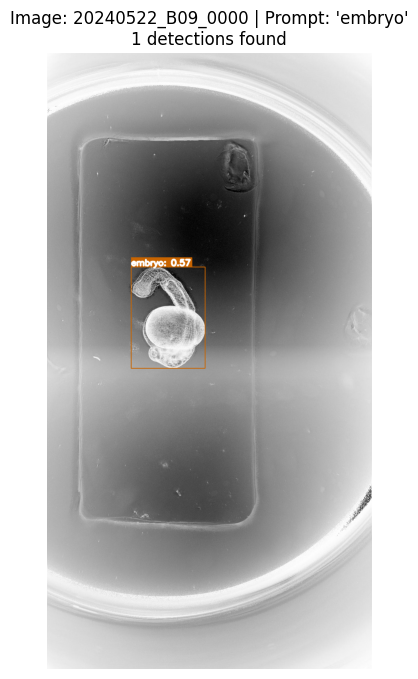

   🔍 [2/9] Running prompt: 'live'
      📍 Found 1 detections
      🏆 Max confidence: 0.458


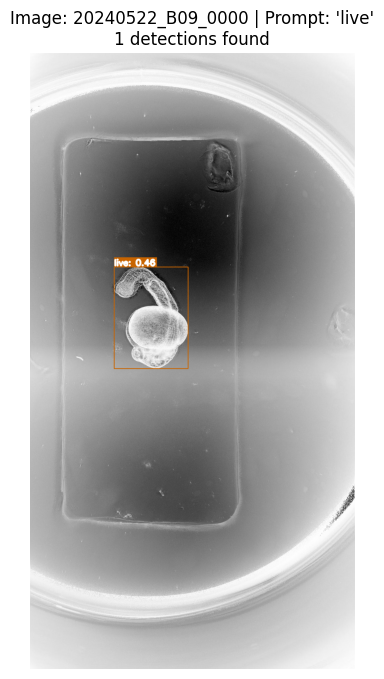

   🔍 [3/9] Running prompt: 'dead'
      📍 Found 0 detections


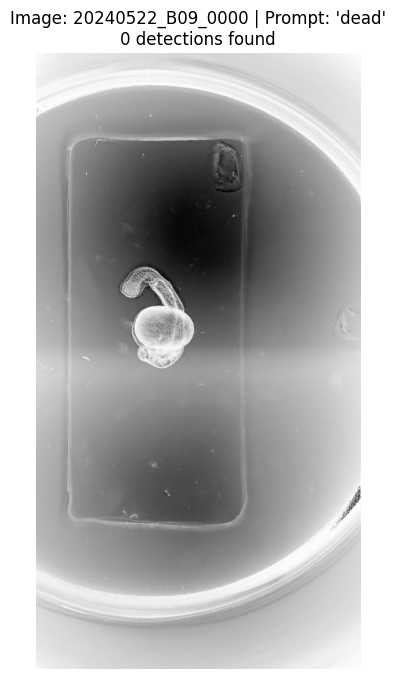


📸 Processing image [2/3]: 20240522_B09_0001
   🔍 [4/9] Running prompt: 'embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.569


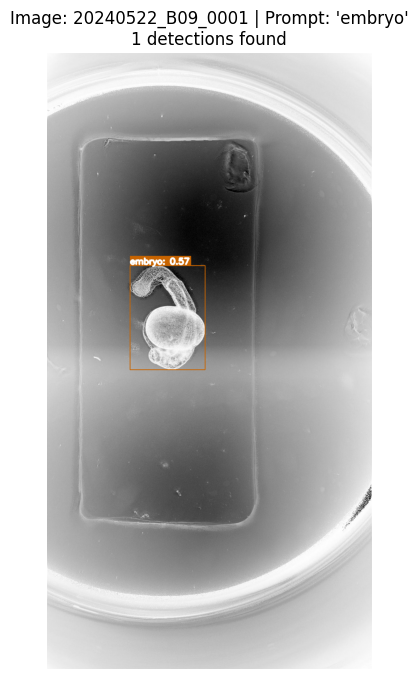

   🔍 [5/9] Running prompt: 'live'
      📍 Found 1 detections
      🏆 Max confidence: 0.459


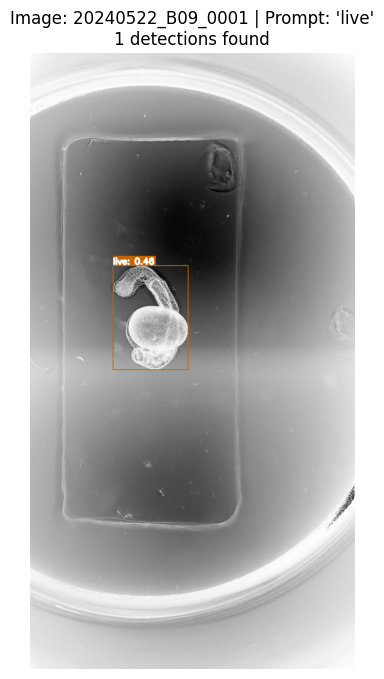

   🔍 [6/9] Running prompt: 'dead'
      📍 Found 0 detections


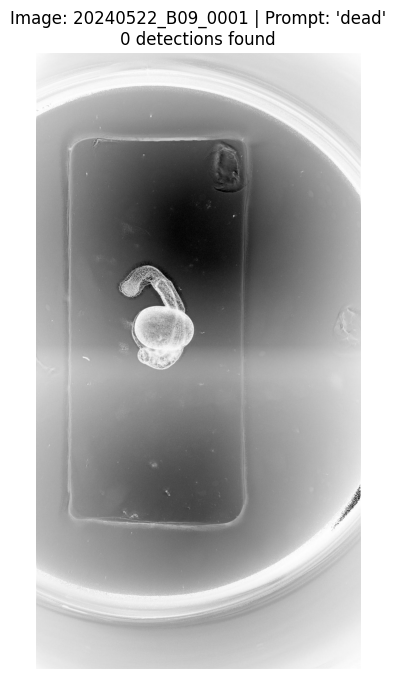


📸 Processing image [3/3]: 20240522_B09_0005
   🔍 [7/9] Running prompt: 'embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.563


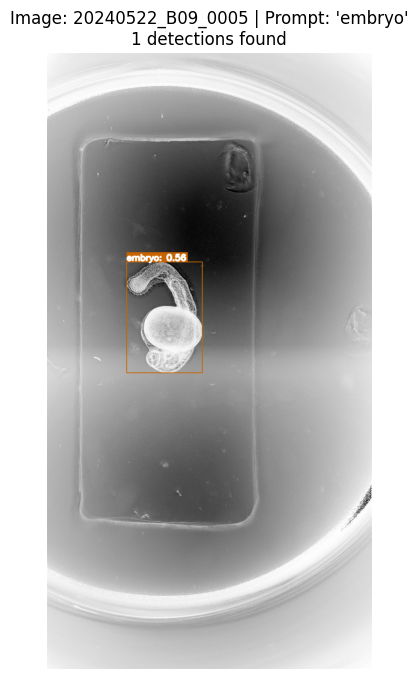

   🔍 [8/9] Running prompt: 'live'
      📍 Found 1 detections
      🏆 Max confidence: 0.458


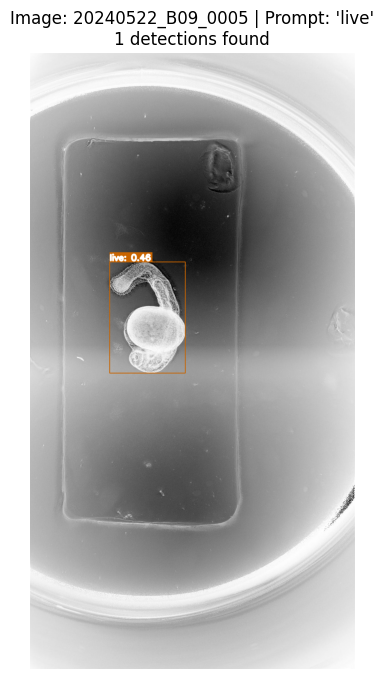

   🔍 [9/9] Running prompt: 'dead'
      📍 Found 0 detections


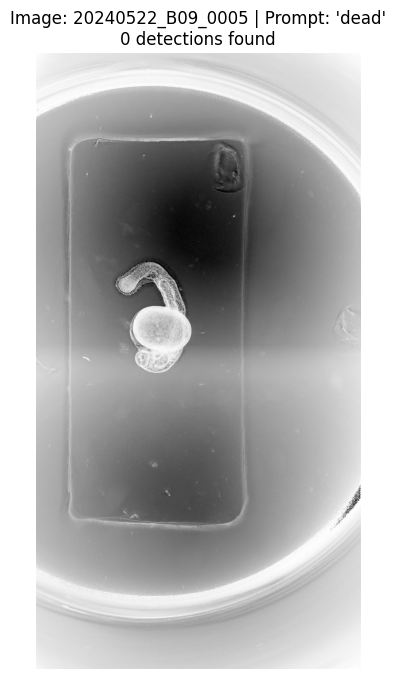


✅ Inference complete! 6 total detections


In [5]:
prompt = ["embryo", 'live', "dead"]

results = gdino_inference_with_visualization(
    model_ft,
    img_paths,
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.5
)

final text_encoder_type: bert-base-uncased
GroundedDINO model loaded successfully on cuda.
🔍 Starting inference for 3 image(s) × 3 prompt(s) = 9 operations

📸 Processing image [1/3]: 20240522_B09_0000
   🔍 [1/9] Running prompt: 'embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.579


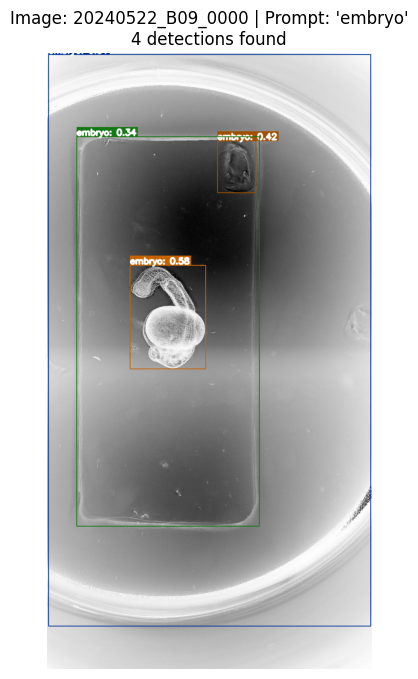

   🔍 [2/9] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.470


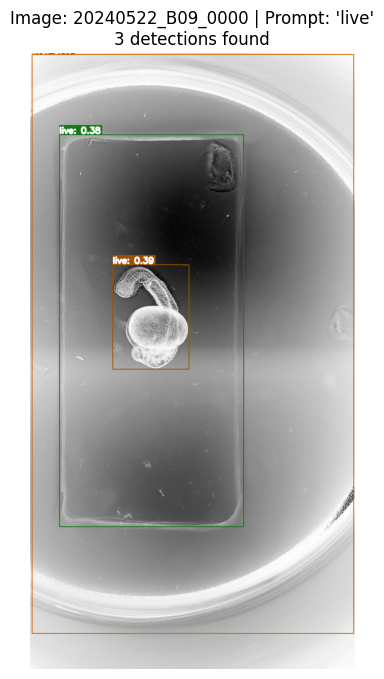

   🔍 [3/9] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.322


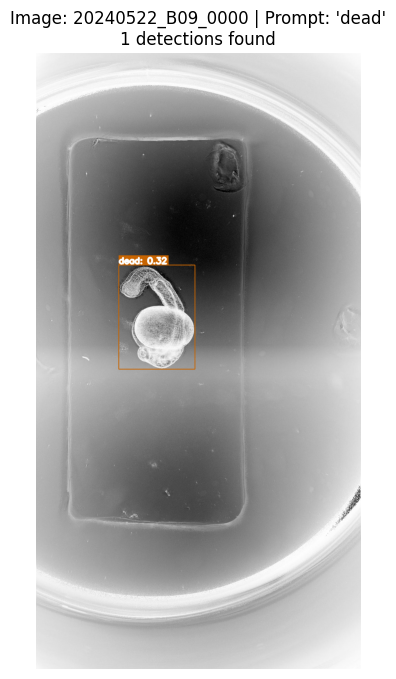


📸 Processing image [2/3]: 20240522_B09_0001
   🔍 [4/9] Running prompt: 'embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.563


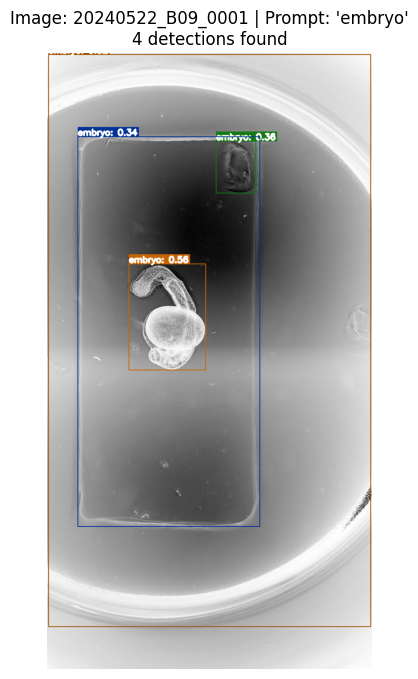

   🔍 [5/9] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.470


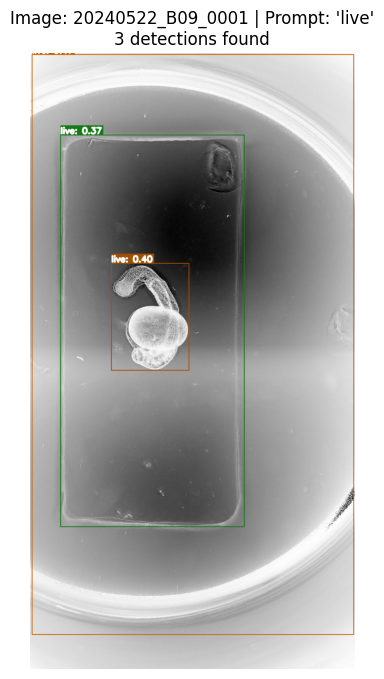

   🔍 [6/9] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.325


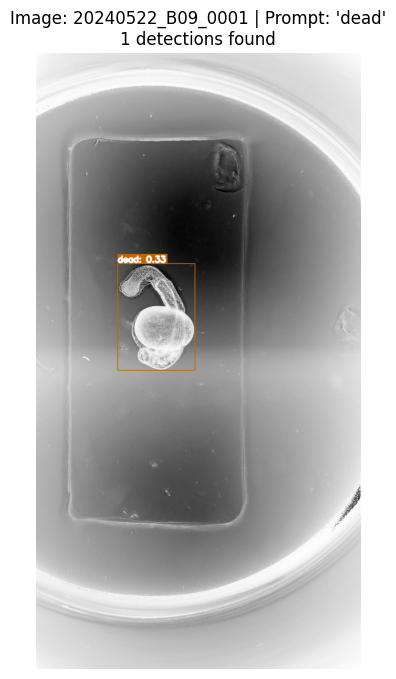


📸 Processing image [3/3]: 20240522_B09_0005
   🔍 [7/9] Running prompt: 'embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.587


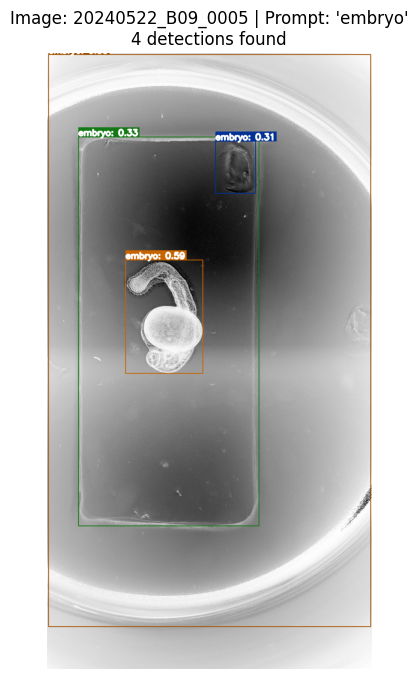

   🔍 [8/9] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.478


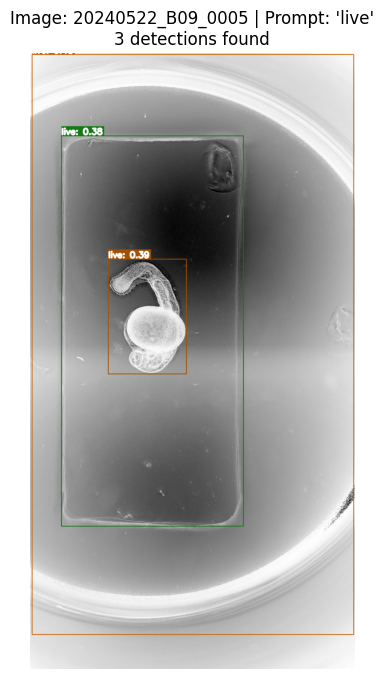

   🔍 [9/9] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.345


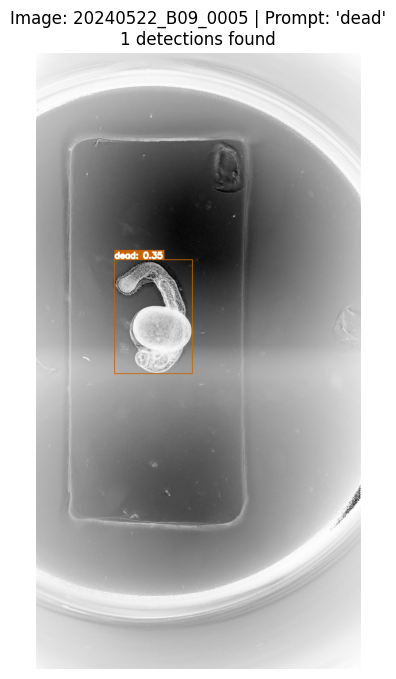


✅ Inference complete! 24 total detections


In [6]:
# Cell 2: Load Config, Metadata, Model, Manager
config = load_config(SANDBOX_ROOT/"configs"/"pipeline_config.yaml")
model = load_groundingdino_model(config, device=device)


results = gdino_inference_with_visualization(
    model,
    img_paths,
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.5
)


🔍 Starting inference for 50 image(s) × 1 prompt(s) = 50 operations

📸 Processing image [1/50]: 20230615_D08_0001
   🔍 [1/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.602


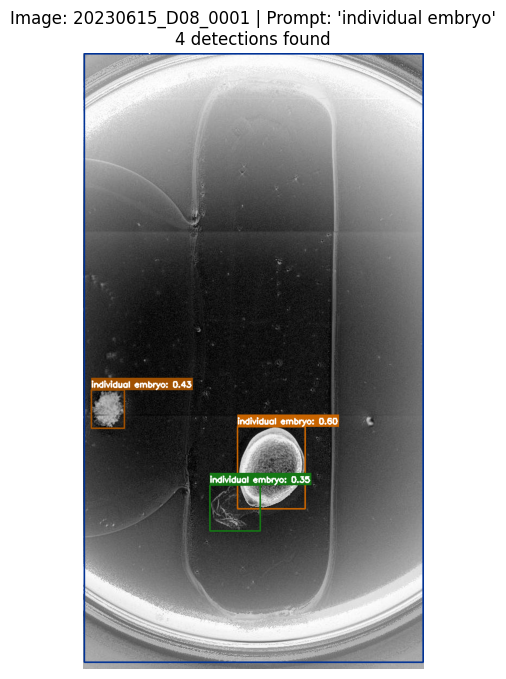


📸 Processing image [2/50]: 20230615_D08_0002
   🔍 [2/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.606


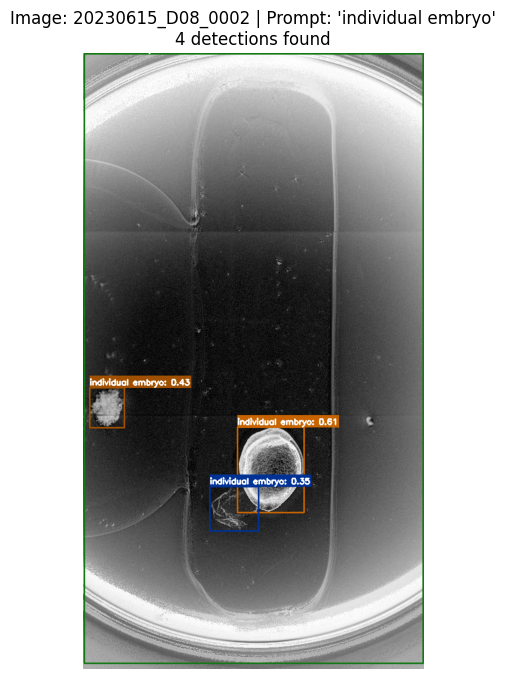


📸 Processing image [3/50]: 20230615_D08_0003
   🔍 [3/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.648


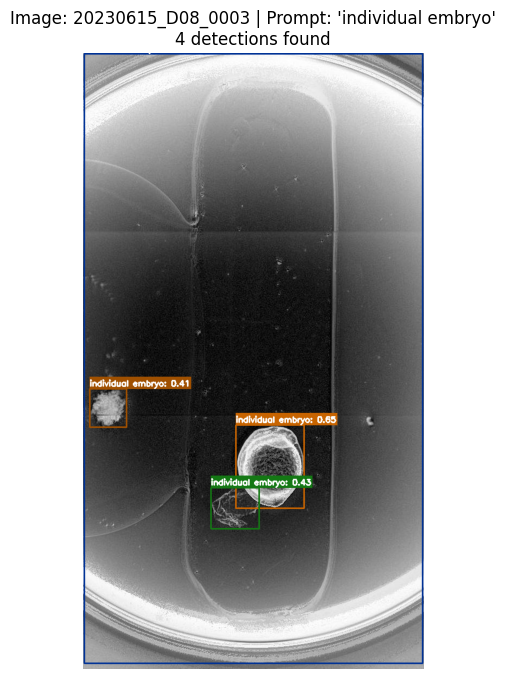


📸 Processing image [4/50]: 20230615_D08_0004
   🔍 [4/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.618


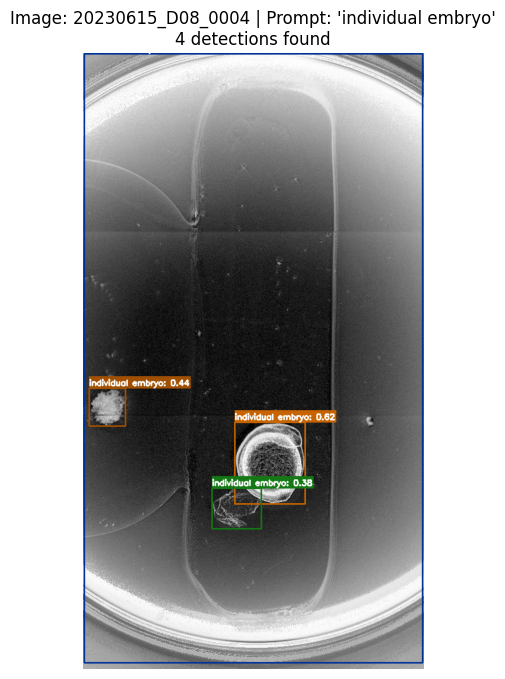


📸 Processing image [5/50]: 20230615_D08_0005
   🔍 [5/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.659


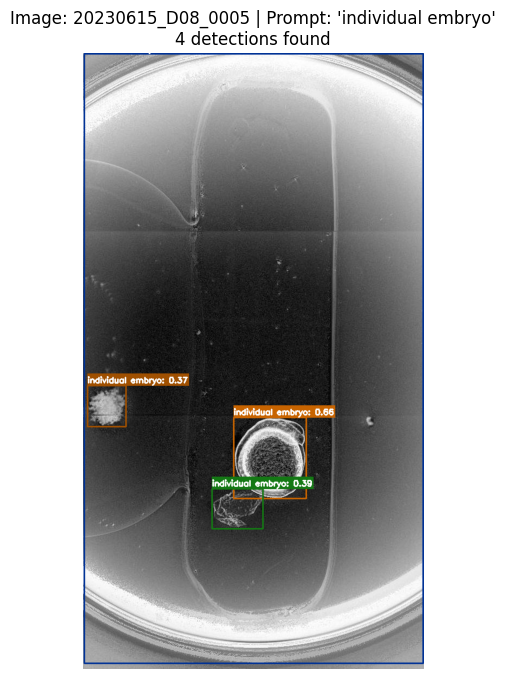


📸 Processing image [6/50]: 20230615_D08_0006
   🔍 [6/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.695


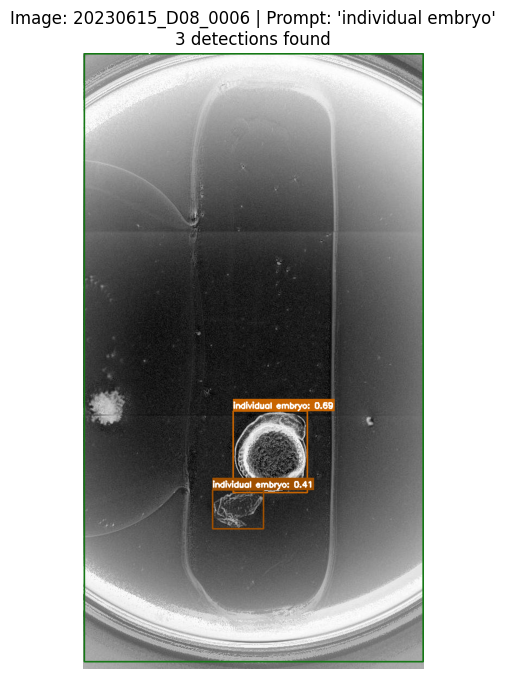


📸 Processing image [7/50]: 20230615_D08_0007
   🔍 [7/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.699


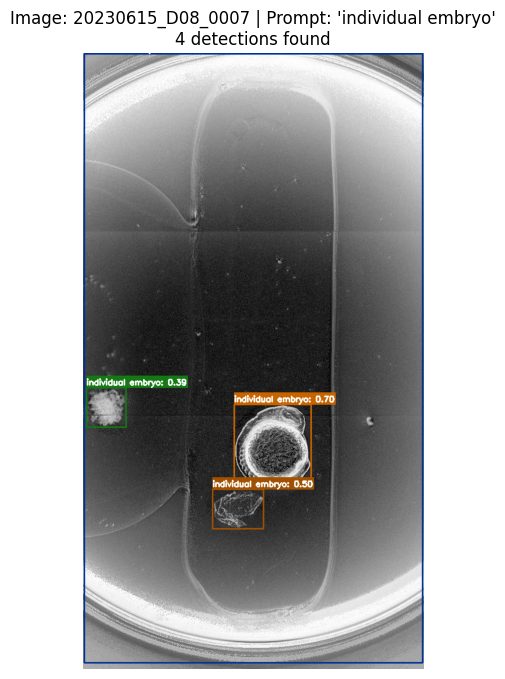


📸 Processing image [8/50]: 20230615_D08_0008
   🔍 [8/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.696


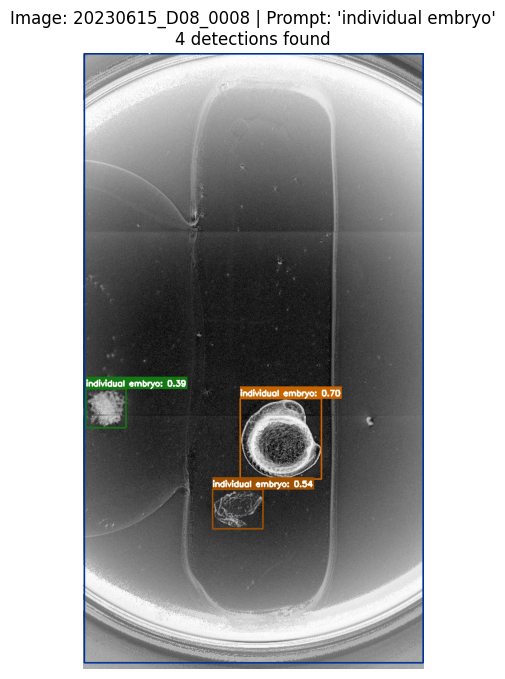


📸 Processing image [9/50]: 20230615_D08_0009
   🔍 [9/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.674


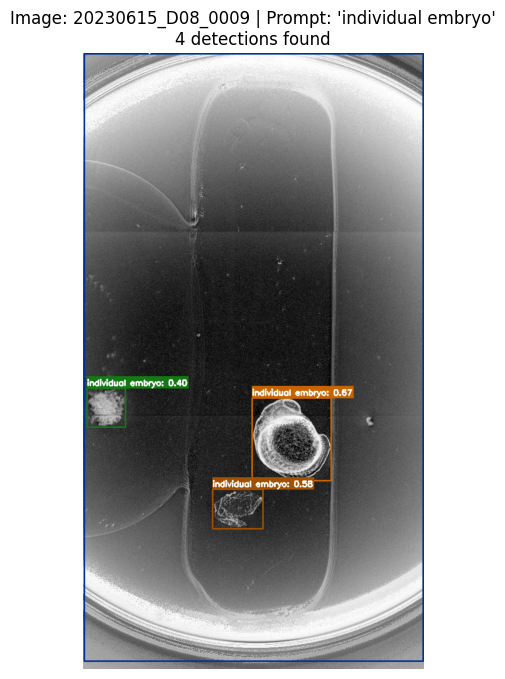


📸 Processing image [10/50]: 20230615_D08_0010
   🔍 [10/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.679


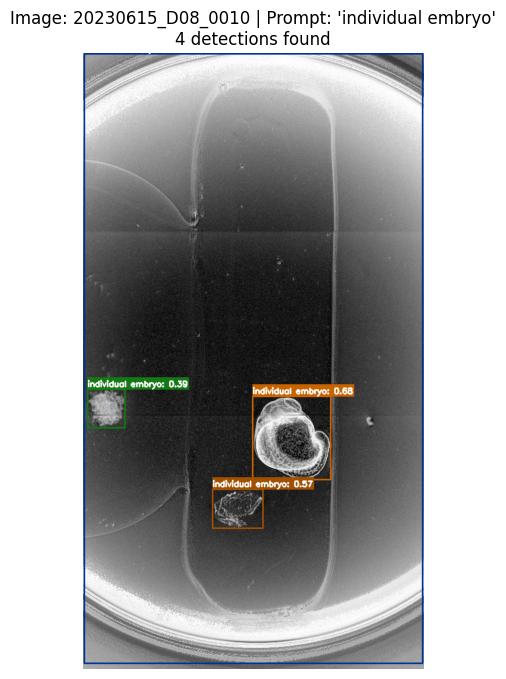


📸 Processing image [11/50]: 20230615_D08_0011
   🔍 [11/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.682


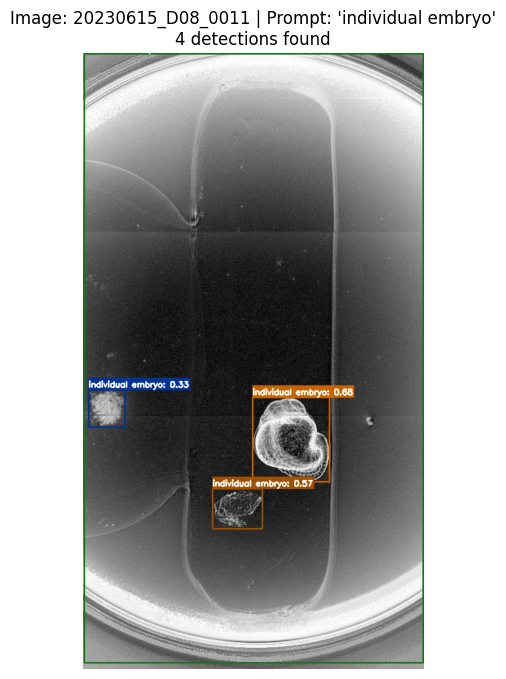


📸 Processing image [12/50]: 20230615_D08_0012
   🔍 [12/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.686


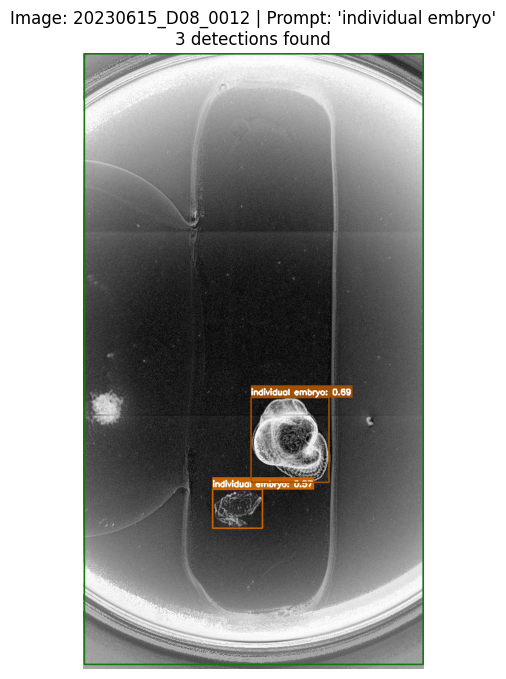


📸 Processing image [13/50]: 20230615_D08_0013
   🔍 [13/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.632


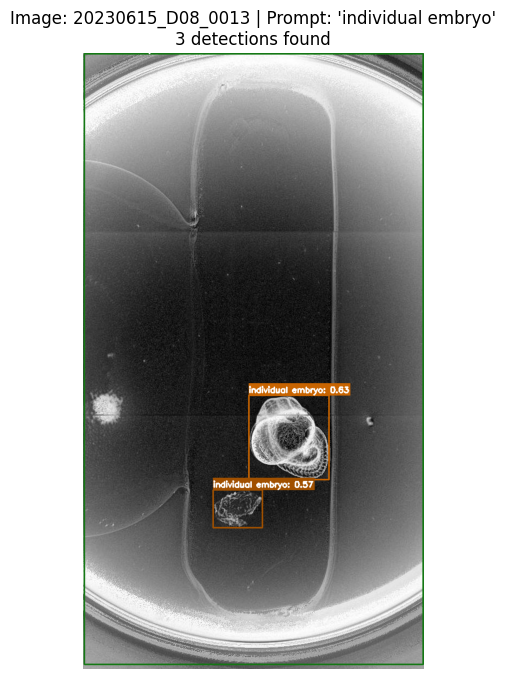


📸 Processing image [14/50]: 20230615_D08_0014
   🔍 [14/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.645


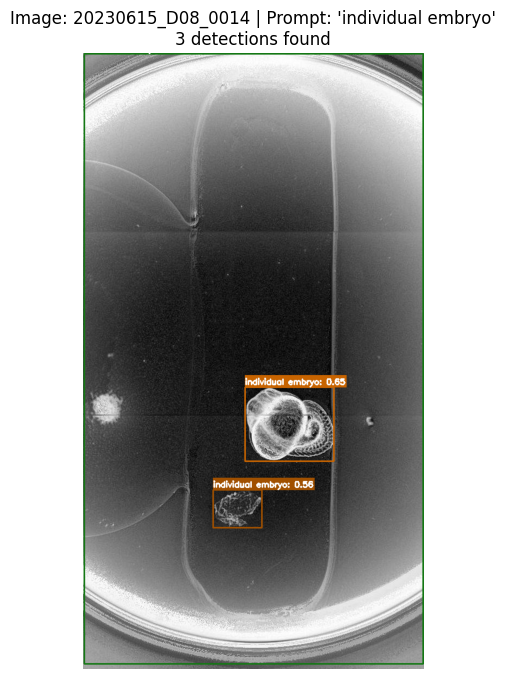


📸 Processing image [15/50]: 20230615_D08_0015
   🔍 [15/50] Running prompt: 'individual embryo'
      📍 Found 5 detections
      🏆 Max confidence: 0.521


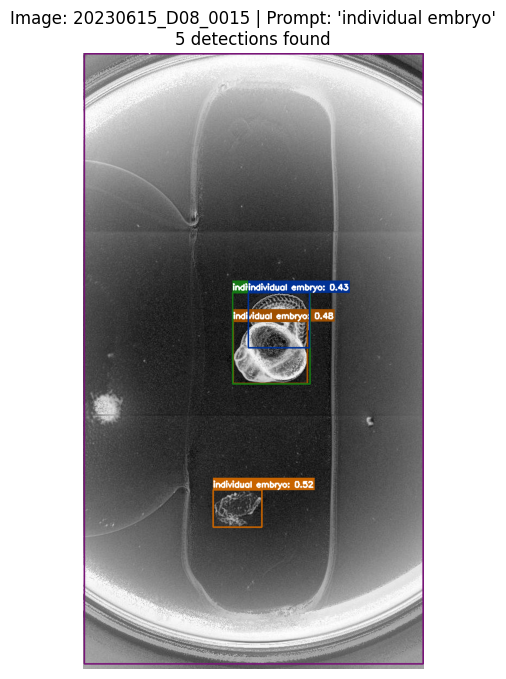


📸 Processing image [16/50]: 20230615_D08_0016
   🔍 [16/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.582


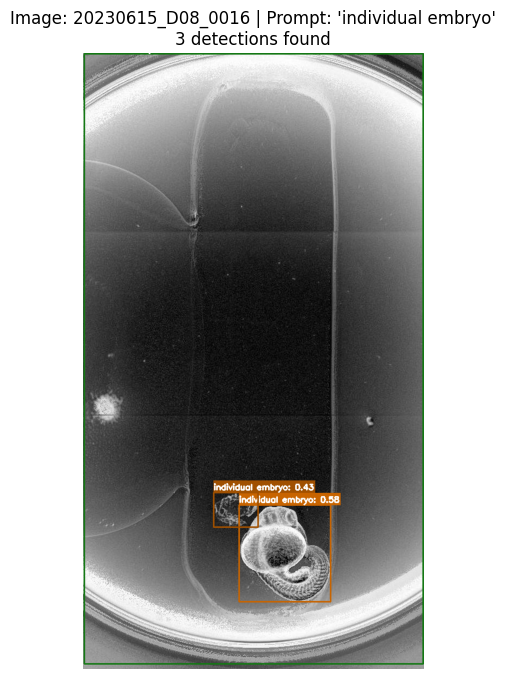


📸 Processing image [17/50]: 20230615_D08_0017
   🔍 [17/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.641


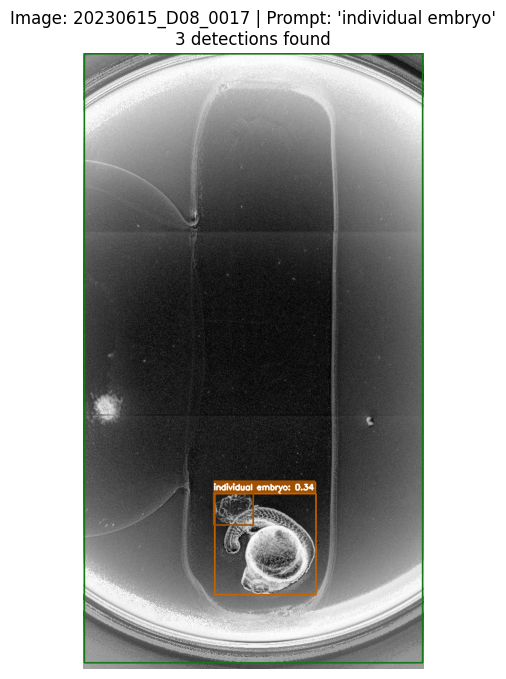


📸 Processing image [18/50]: 20230615_D08_0018
   🔍 [18/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.614


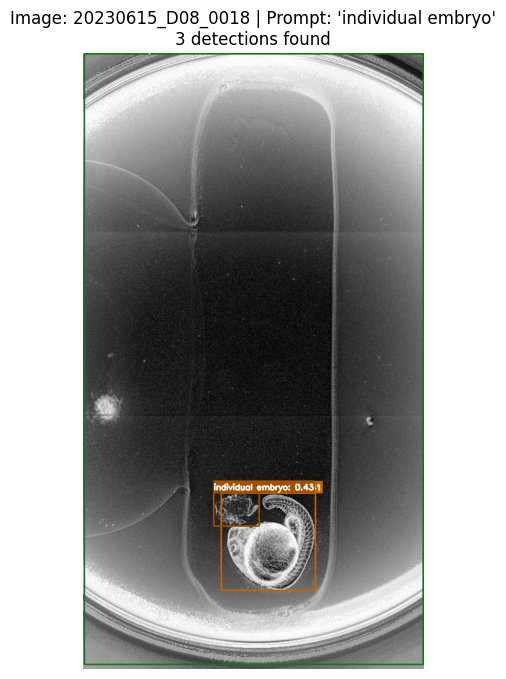


📸 Processing image [19/50]: 20230615_D08_0019
   🔍 [19/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.655


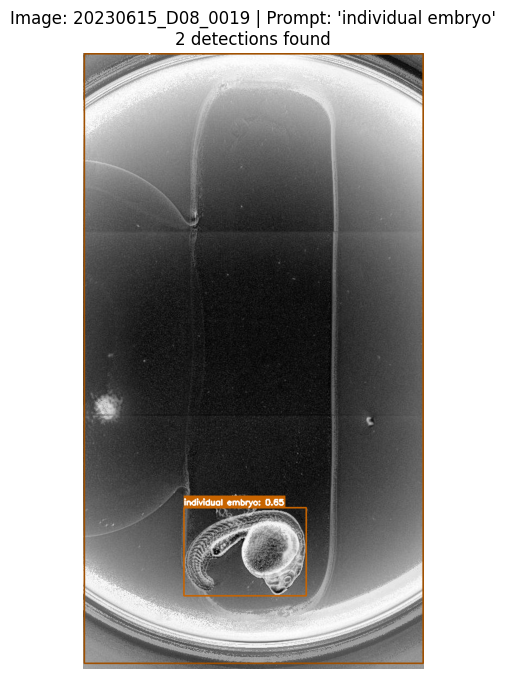


📸 Processing image [20/50]: 20230615_D08_0020
   🔍 [20/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.570


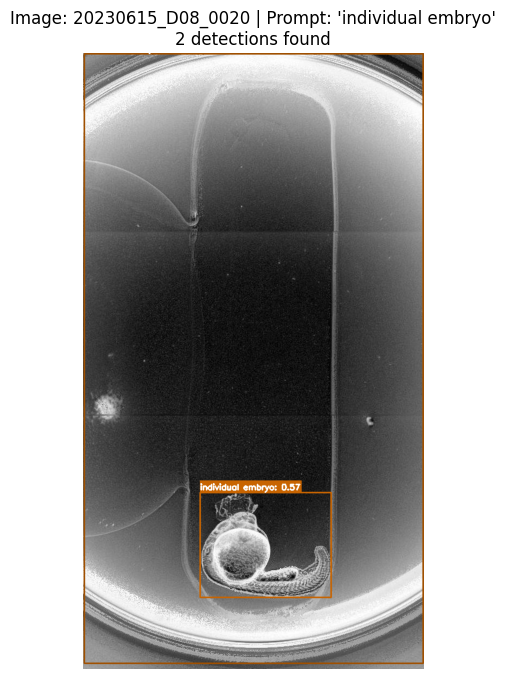


📸 Processing image [21/50]: 20230615_D08_0021
   🔍 [21/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.601


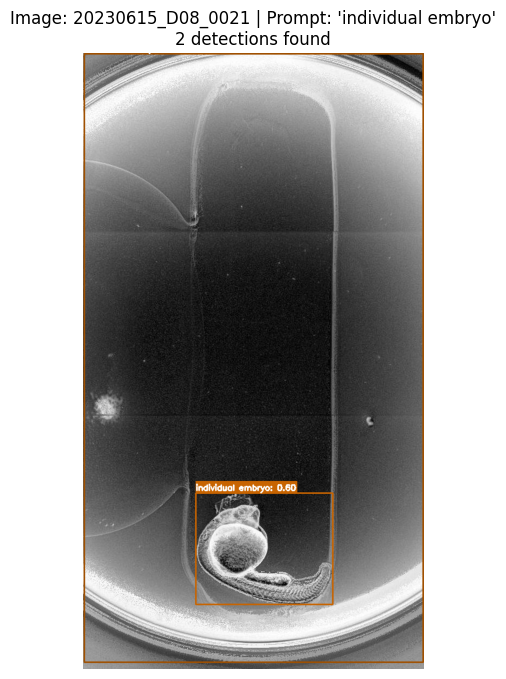


📸 Processing image [22/50]: 20230615_D08_0022
   🔍 [22/50] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.410


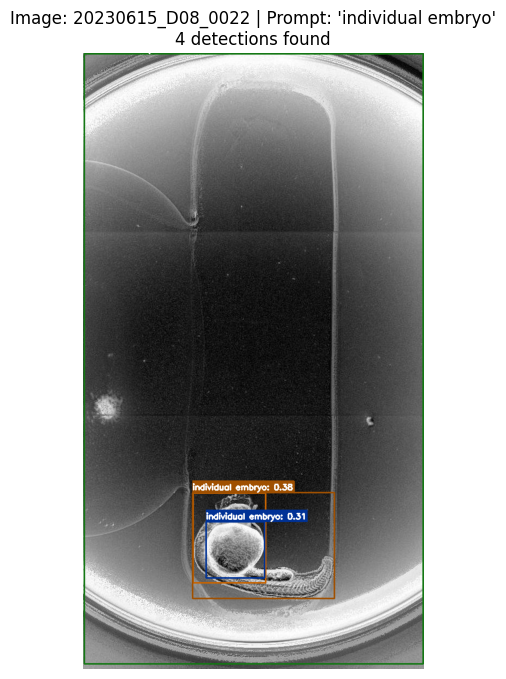


📸 Processing image [23/50]: 20230615_D08_0023
   🔍 [23/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.515


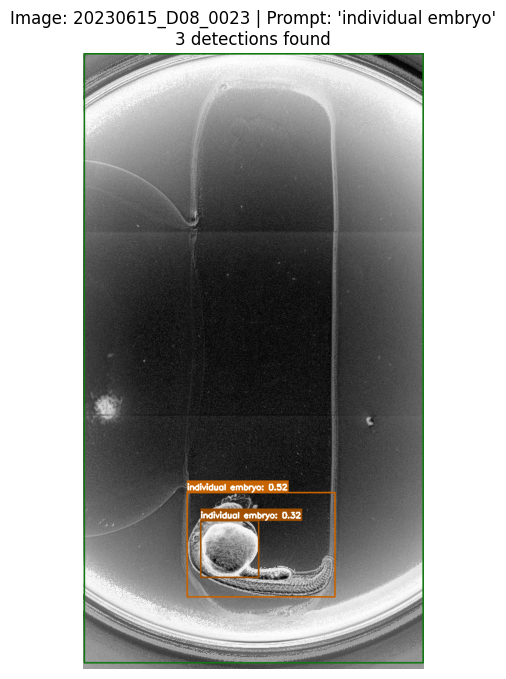


📸 Processing image [24/50]: 20230615_D08_0024
   🔍 [24/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.424


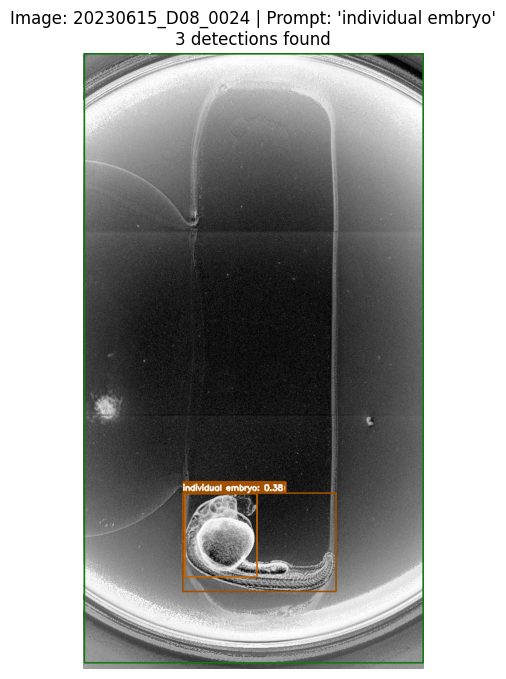


📸 Processing image [25/50]: 20230615_D08_0025
   🔍 [25/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.488


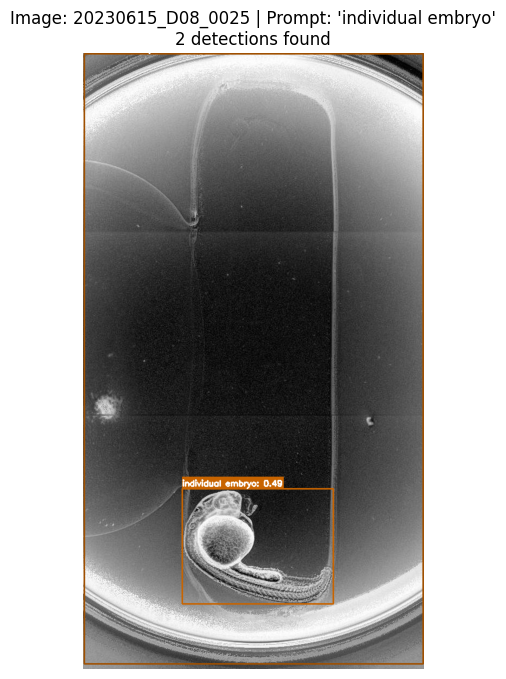


📸 Processing image [26/50]: 20230615_D08_0026
   🔍 [26/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.587


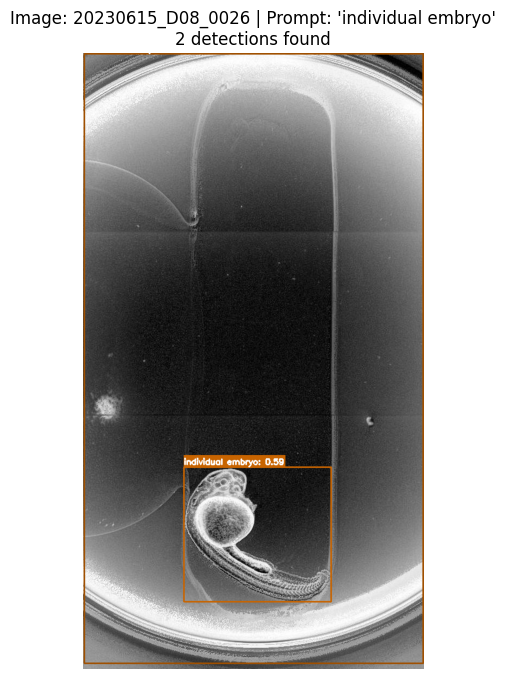


📸 Processing image [27/50]: 20230615_D08_0027
   🔍 [27/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.593


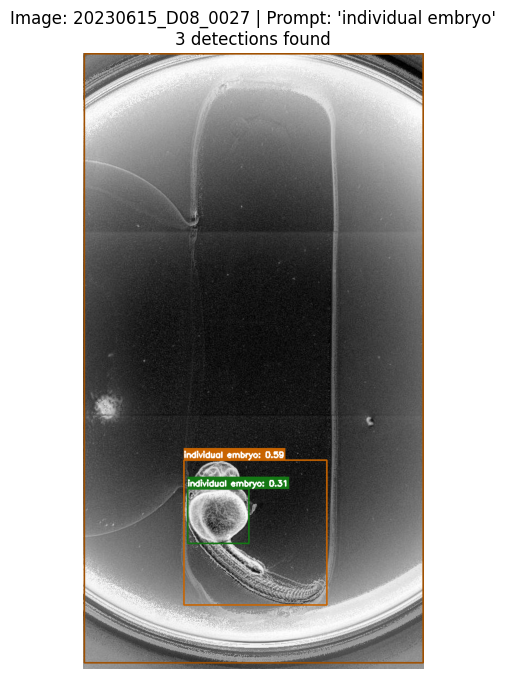


📸 Processing image [28/50]: 20230615_D08_0028
   🔍 [28/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.683


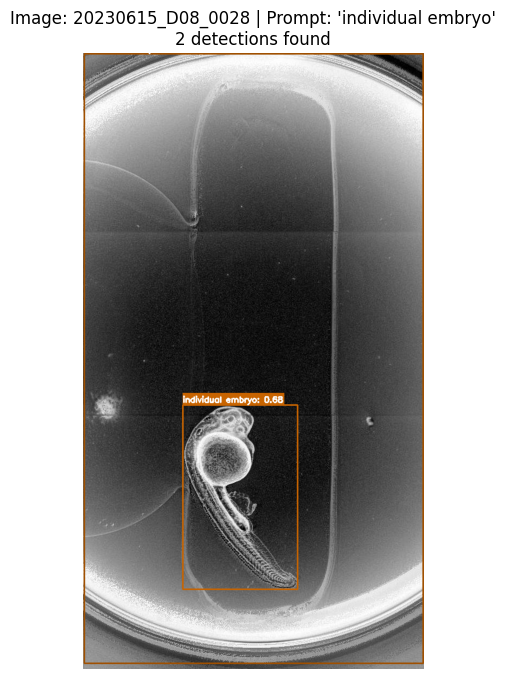


📸 Processing image [29/50]: 20230615_D08_0029
   🔍 [29/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.656


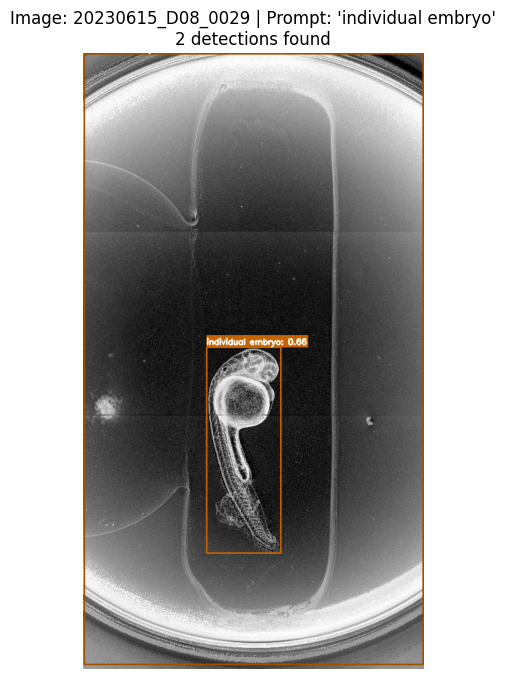


📸 Processing image [30/50]: 20230615_D08_0030
   🔍 [30/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.678


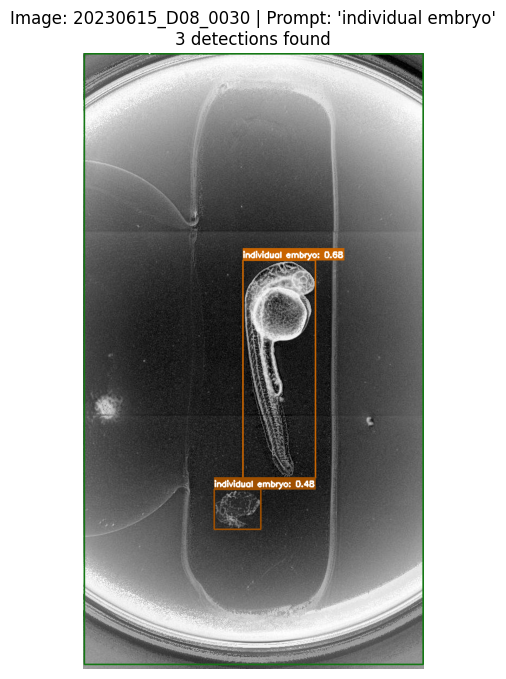


📸 Processing image [31/50]: 20230615_D08_0031
   🔍 [31/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.659


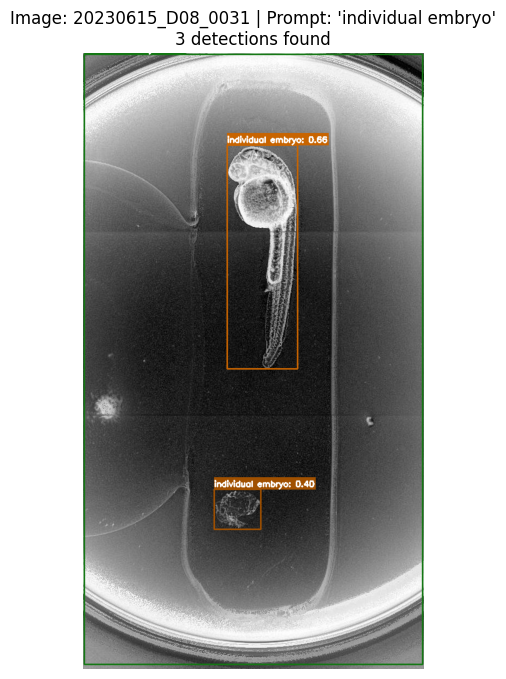


📸 Processing image [32/50]: 20230615_D08_0032
   🔍 [32/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.625


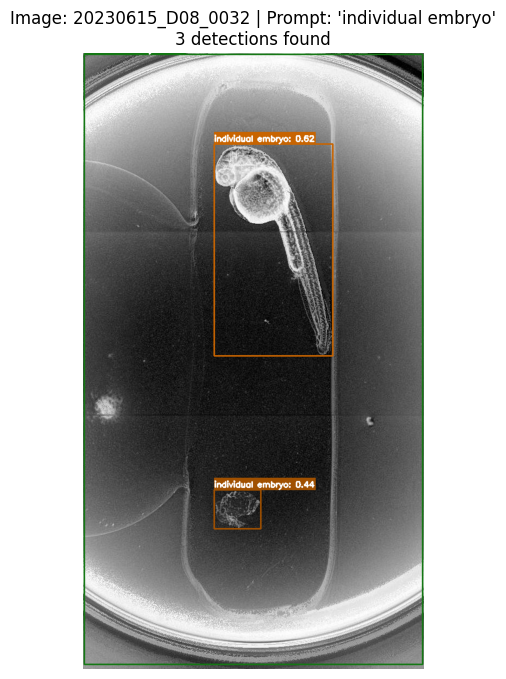


📸 Processing image [33/50]: 20230615_D08_0033
   🔍 [33/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.596


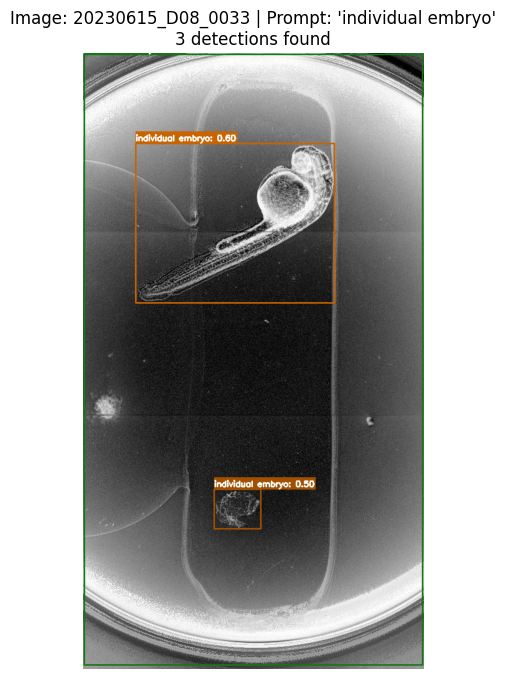


📸 Processing image [34/50]: 20230615_D08_0034
   🔍 [34/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.585


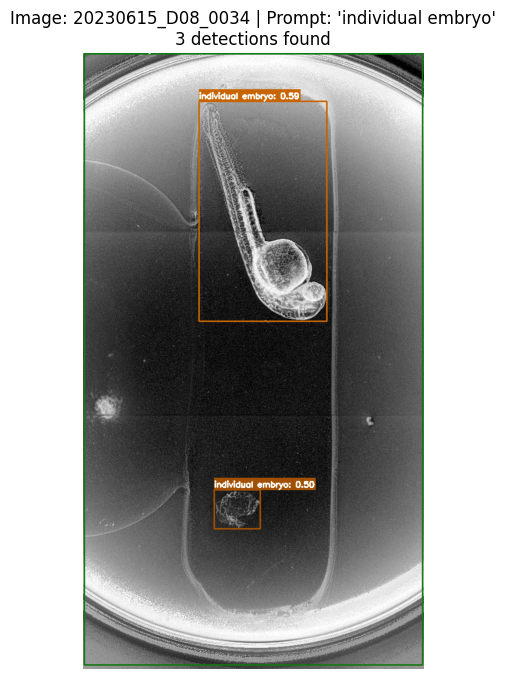


📸 Processing image [35/50]: 20230615_D08_0035
   🔍 [35/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.625


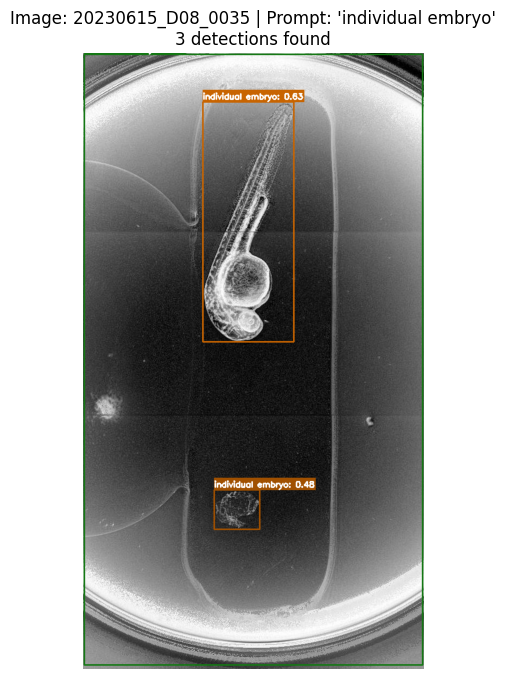


📸 Processing image [36/50]: 20230615_D08_0036
   🔍 [36/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.516


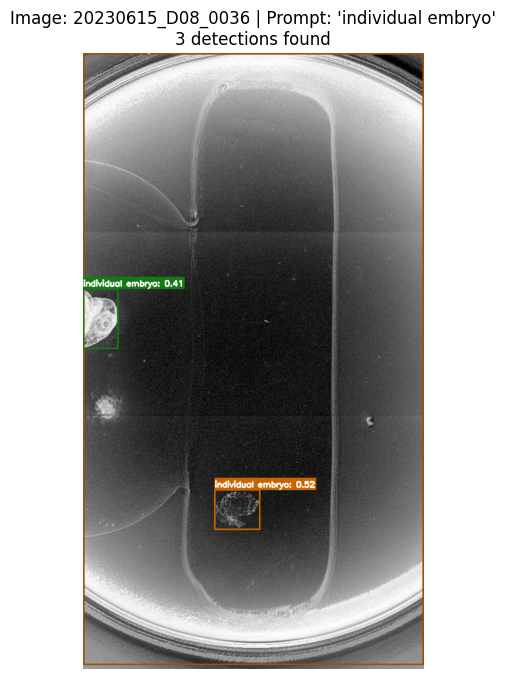


📸 Processing image [37/50]: 20230615_D08_0037
   🔍 [37/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.525


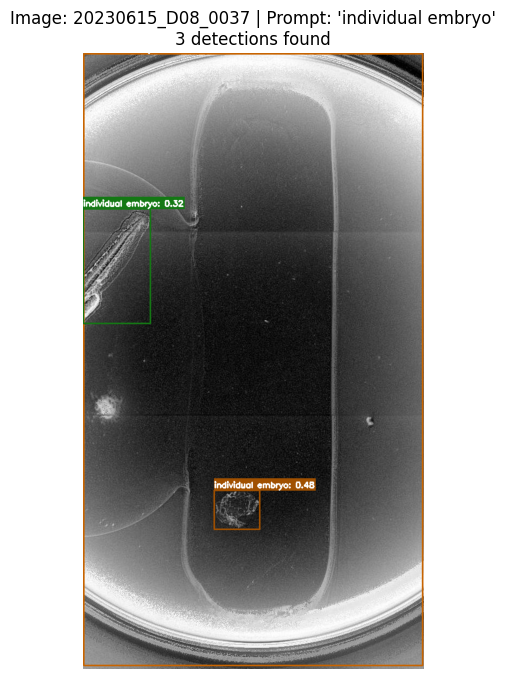


📸 Processing image [38/50]: 20230615_D08_0038
   🔍 [38/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.555


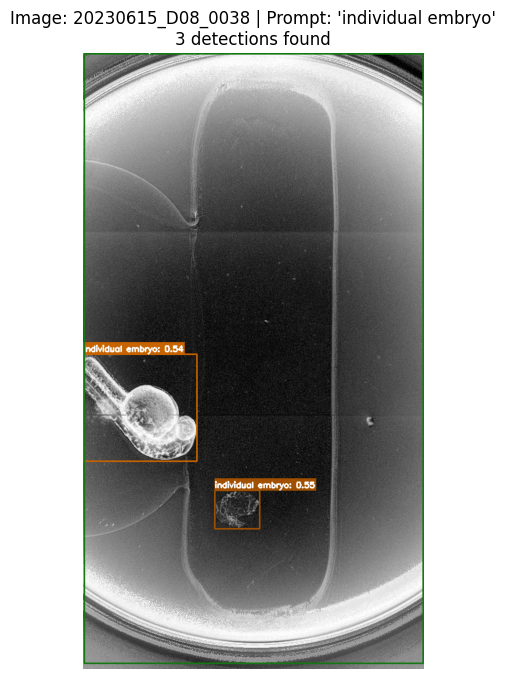


📸 Processing image [39/50]: 20230615_D08_0039
   🔍 [39/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.558


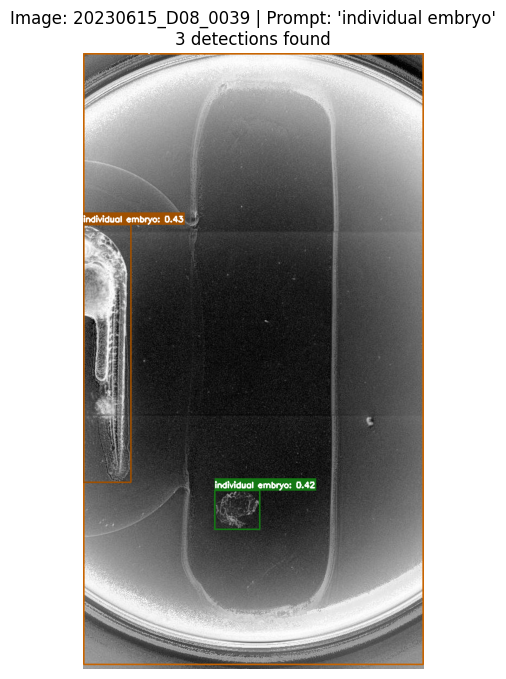


📸 Processing image [40/50]: 20230615_D08_0040
   🔍 [40/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.536


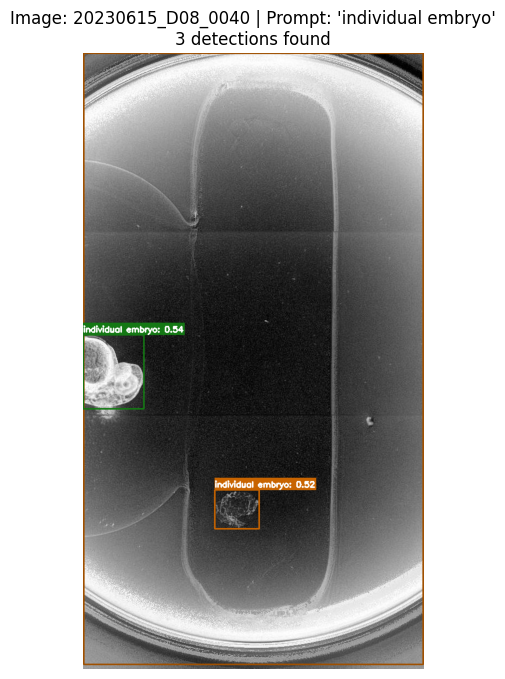


📸 Processing image [41/50]: 20230615_D08_0041
   🔍 [41/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.571


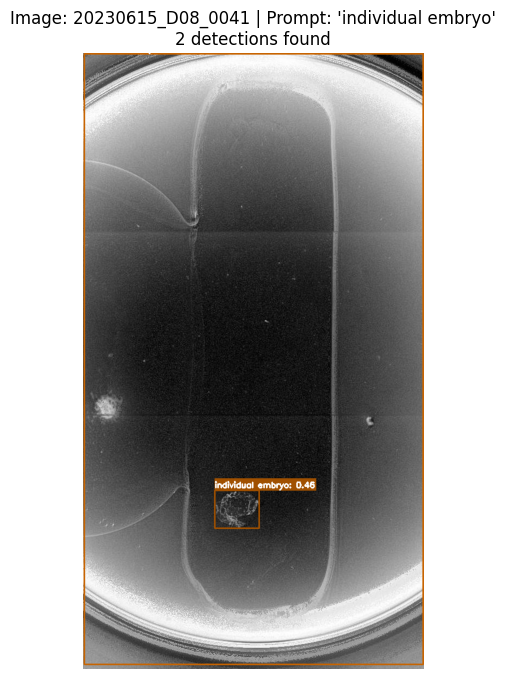


📸 Processing image [42/50]: 20230615_D08_0042
   🔍 [42/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.537


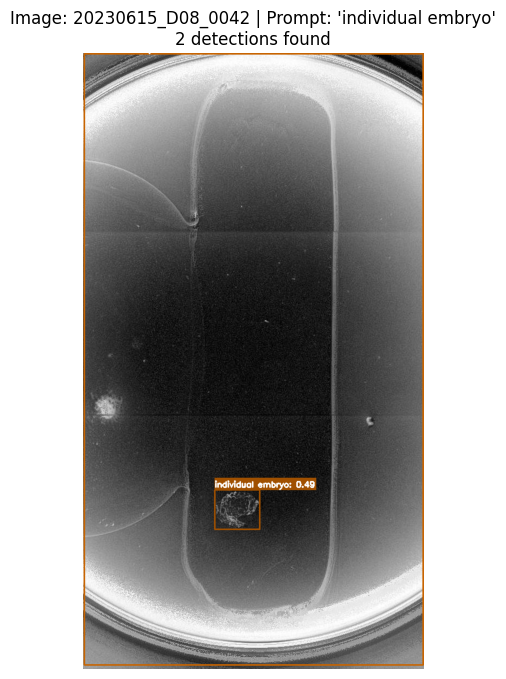


📸 Processing image [43/50]: 20230615_D08_0043
   🔍 [43/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.609


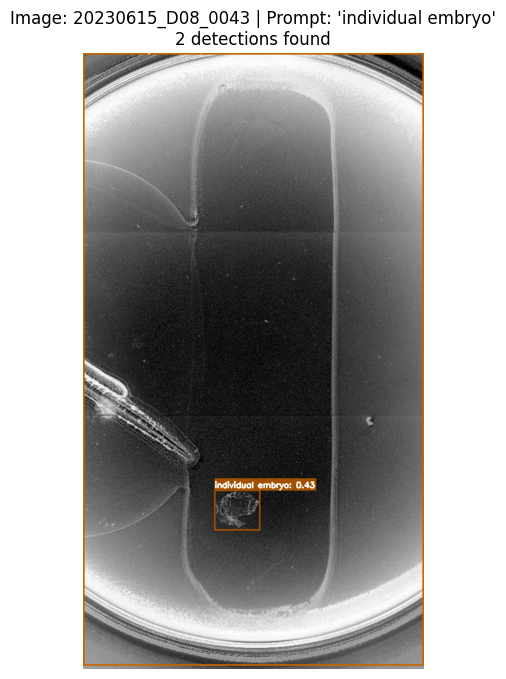


📸 Processing image [44/50]: 20230615_D08_0044
   🔍 [44/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.568


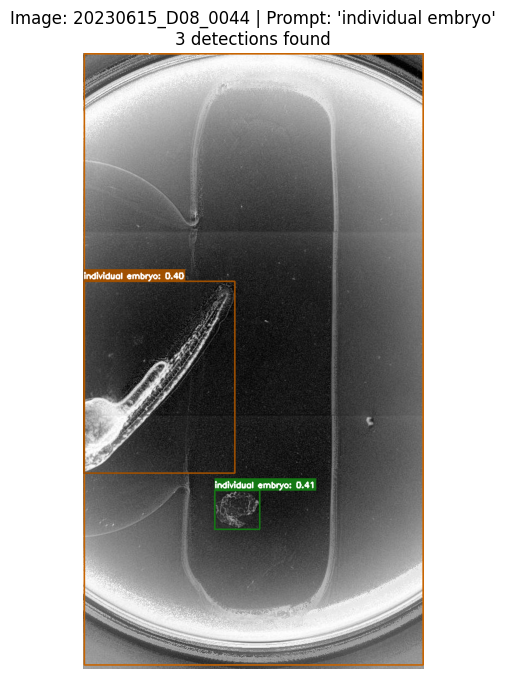


📸 Processing image [45/50]: 20230615_D08_0045
   🔍 [45/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.605


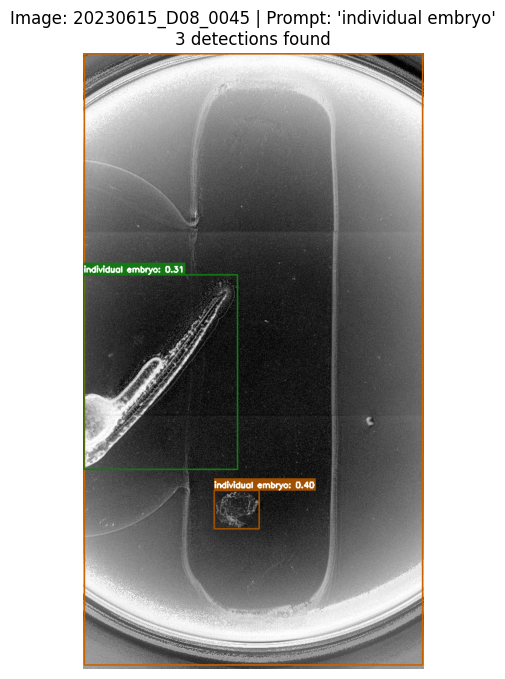


📸 Processing image [46/50]: 20230615_D08_0046
   🔍 [46/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.532


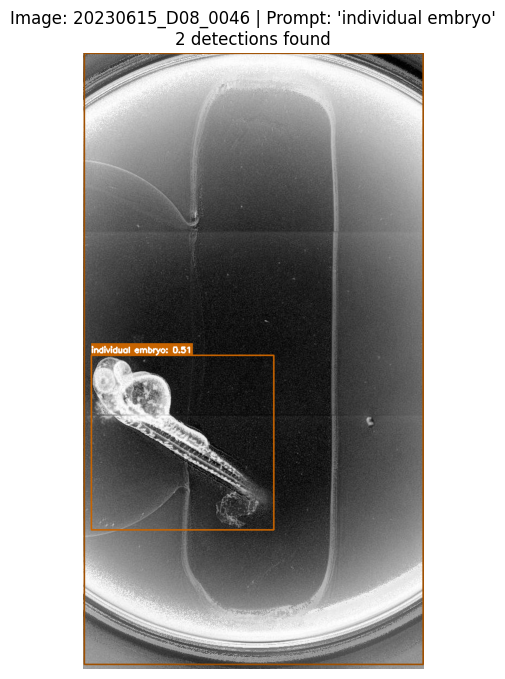


📸 Processing image [47/50]: 20230615_D08_0047
   🔍 [47/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.526


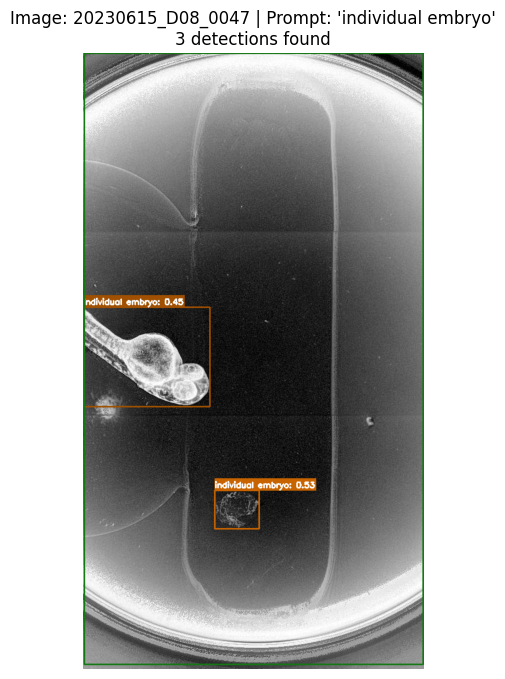


📸 Processing image [48/50]: 20230615_D08_0048
   🔍 [48/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.505


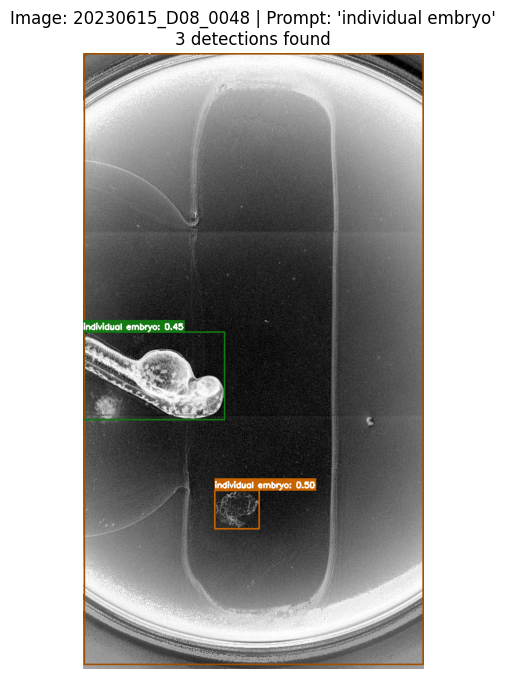


📸 Processing image [49/50]: 20230615_D08_0049
   🔍 [49/50] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.498


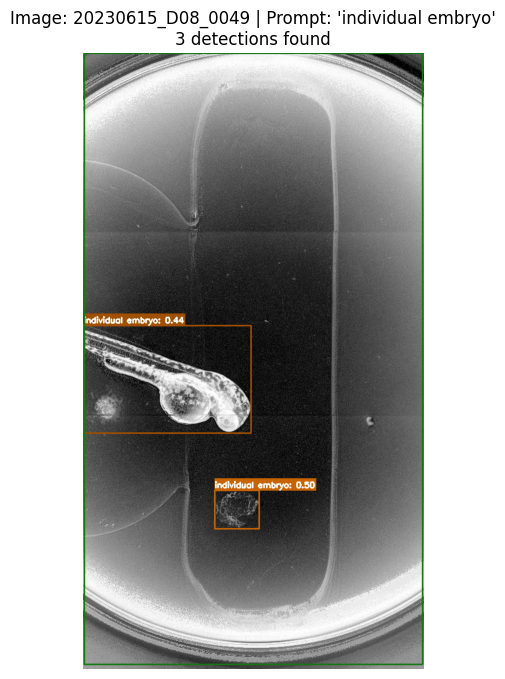


📸 Processing image [50/50]: 20230615_D08_0050
   🔍 [50/50] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.530


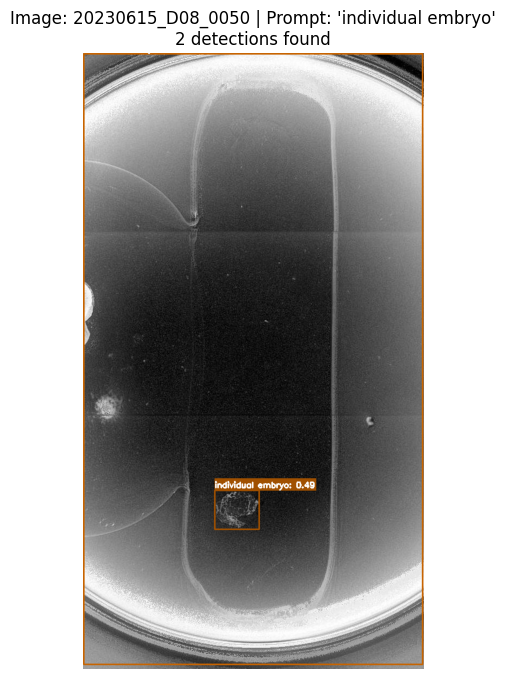


✅ Inference complete! 151 total detections


In [17]:

prompt = ["individual embryo"]

video_id = "20230615_D08"
metadata_path = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/raw_data_organized/experiment_metadata.json"

image_ids = list_image_ids_for_video(video_id, metadata_path)

img_paths = get_image_id_paths(image_ids, exper_metadata)

results = gdino_inference_with_visualization(
    model,
    img_paths,
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.25
)


🔍 Starting inference for 1 image(s) × 3 prompt(s) = 3 operations

📸 Processing image [1/1]: embryos_overlapping
   🔍 [1/3] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.590


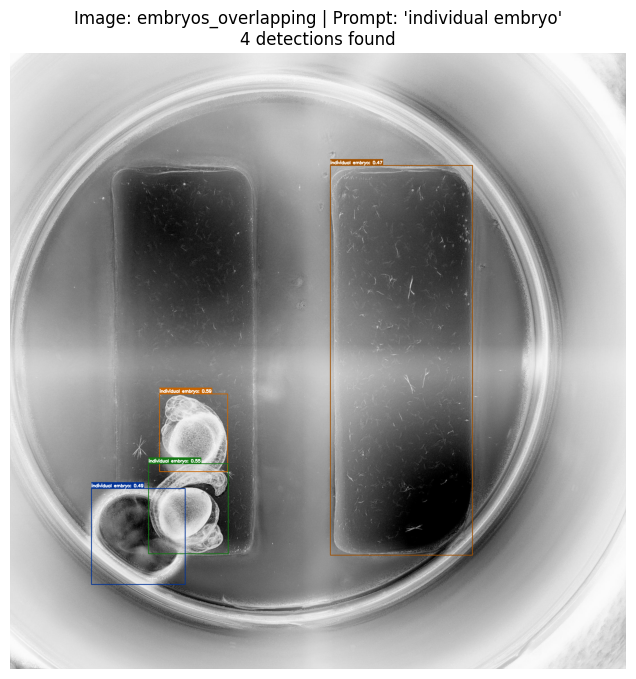

   🔍 [2/3] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.542


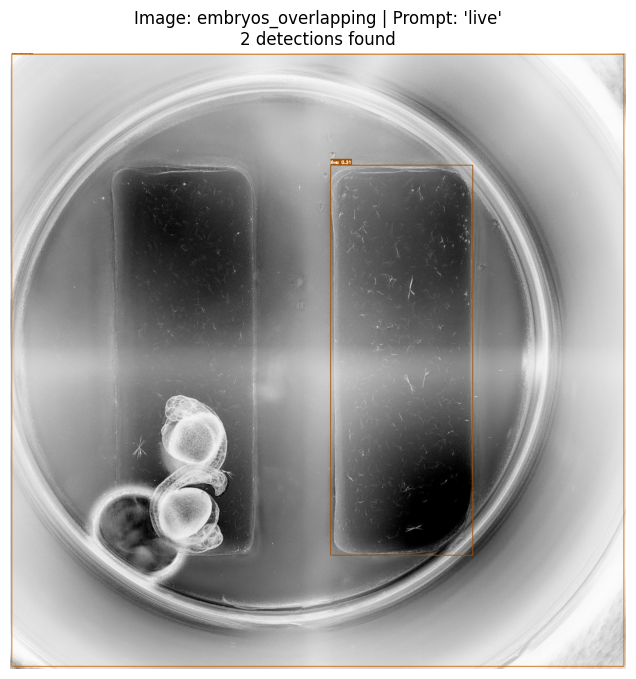

   🔍 [3/3] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.314


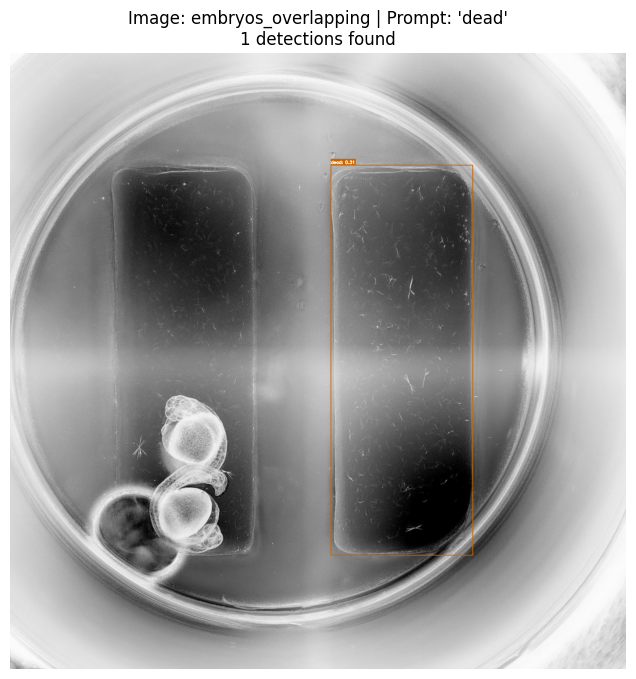


✅ Inference complete! 7 total detections


In [22]:

path = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/test_images/embryos_overlapping.jpg"

results = gdino_inference_with_visualization(
    model,
    path,
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.25
)

🔍 Starting inference for 1 image(s) × 3 prompt(s) = 3 operations

📸 Processing image [1/1]: embryos_overlapping
   🔍 [1/3] Running prompt: 'individual embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.367


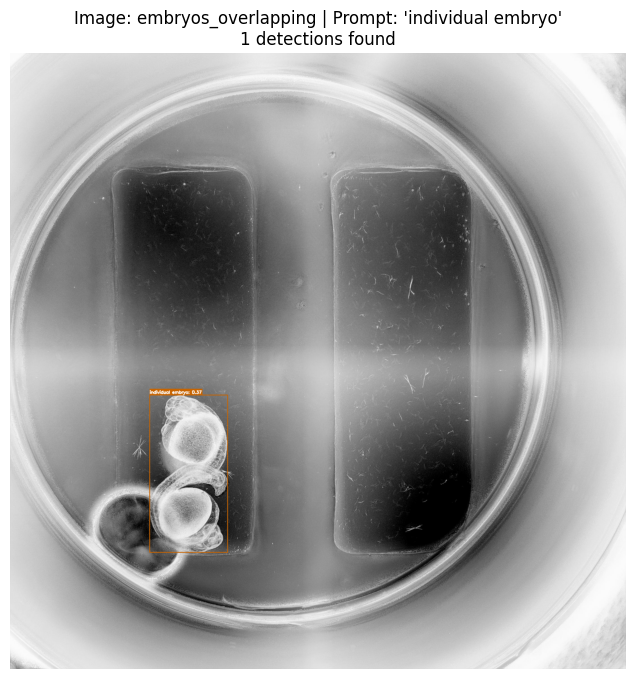

   🔍 [2/3] Running prompt: 'live'
      📍 Found 1 detections
      🏆 Max confidence: 0.367


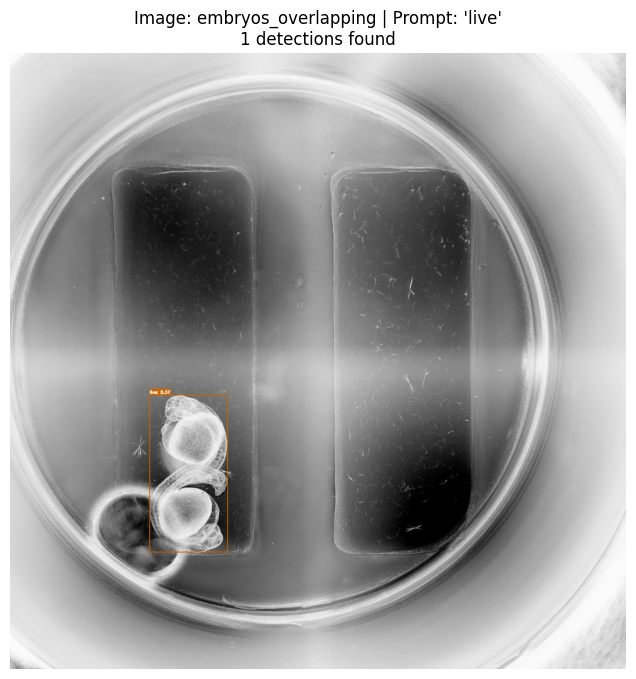

   🔍 [3/3] Running prompt: 'dead'
      📍 Found 0 detections


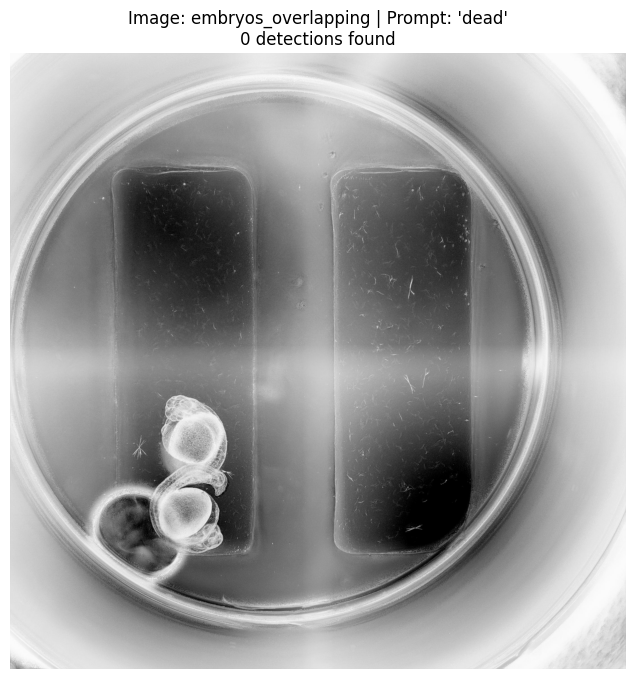


✅ Inference complete! 2 total detections


In [21]:
path = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/test_images/embryos_overlapping.jpg"

results = gdino_inference_with_visualization(
    model_ft,
    path,
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.25
)

🔍 Starting inference for 4 image(s) × 1 prompt(s) = 4 operations

📸 Processing image [1/4]: 20230615_D08_0001
   🔍 [1/4] Running prompt: 'individual embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.510


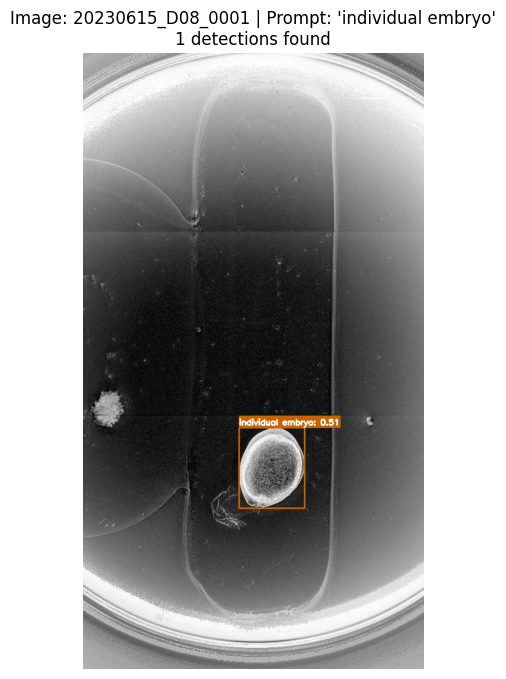


📸 Processing image [2/4]: 20230615_D08_0002
   🔍 [2/4] Running prompt: 'individual embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.510


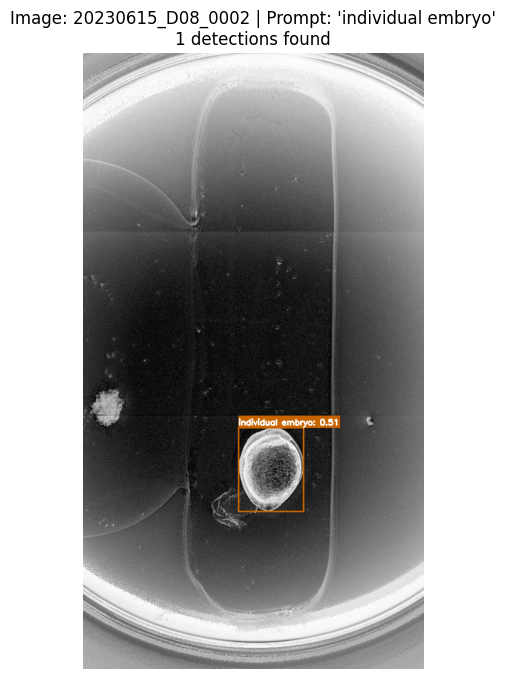


📸 Processing image [3/4]: 20230615_D08_0003
   🔍 [3/4] Running prompt: 'individual embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.522


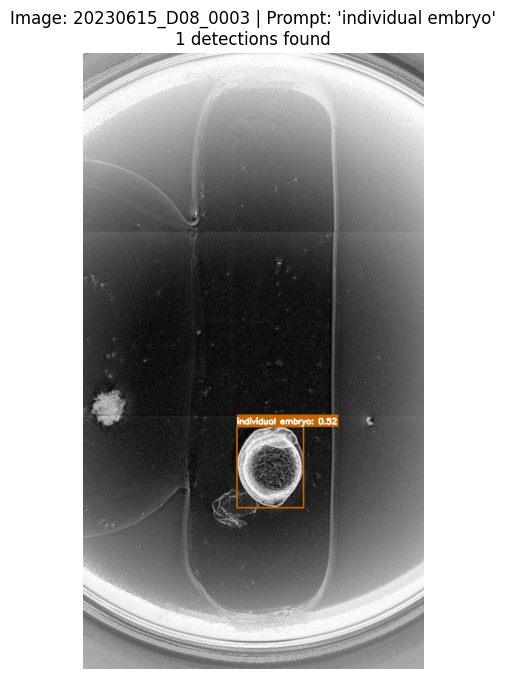


📸 Processing image [4/4]: 20230615_D08_0004
   🔍 [4/4] Running prompt: 'individual embryo'
      📍 Found 1 detections
      🏆 Max confidence: 0.516


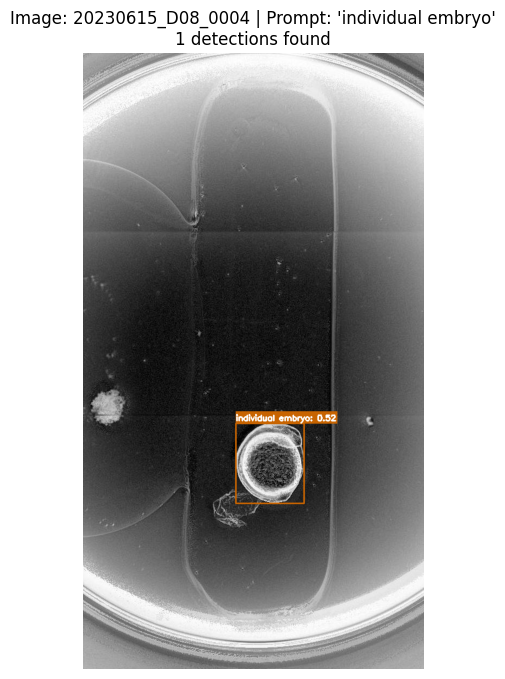


✅ Inference complete! 4 total detections


In [19]:

results = gdino_inference_with_visualization(
    model_ft,
    img_paths[0:4],
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.25
)

🔍 Starting inference for 22 image(s) × 3 prompt(s) = 66 operations

📸 Processing image [1/22]: 20230531_E06_0001
   🔍 [1/66] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.706


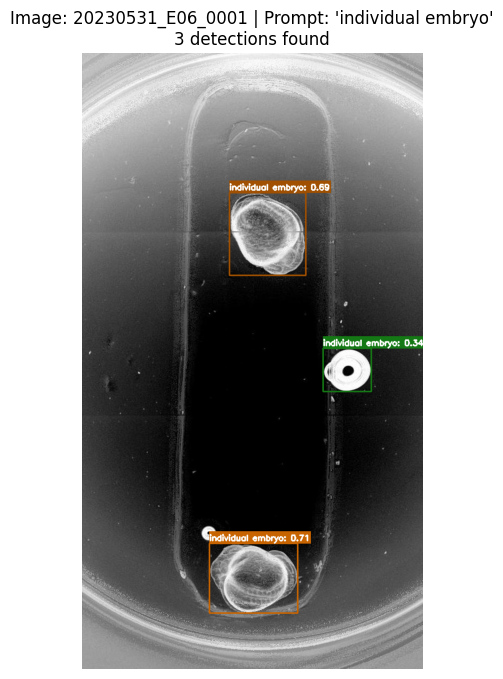

   🔍 [2/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.583


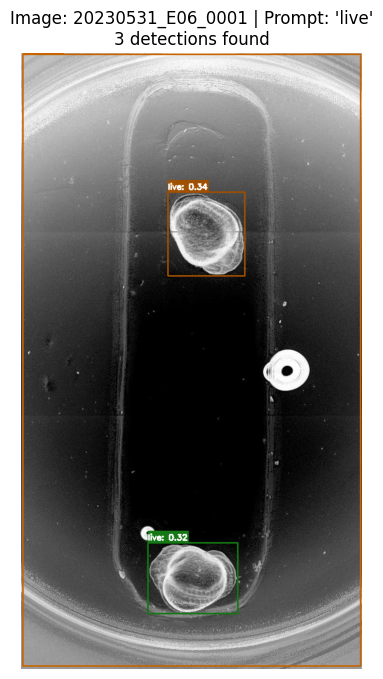

   🔍 [3/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.303


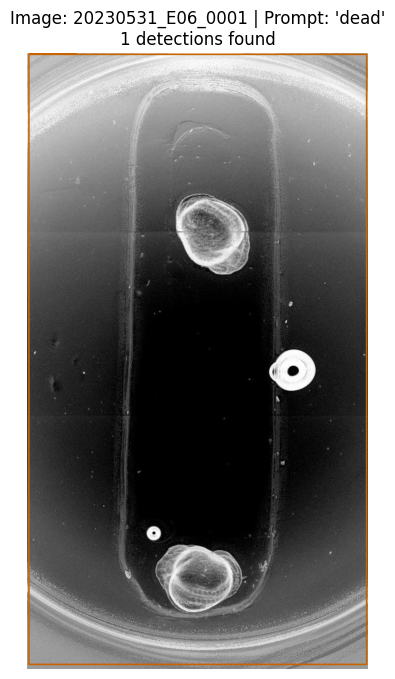


📸 Processing image [2/22]: 20230531_E06_0004
   🔍 [4/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.691


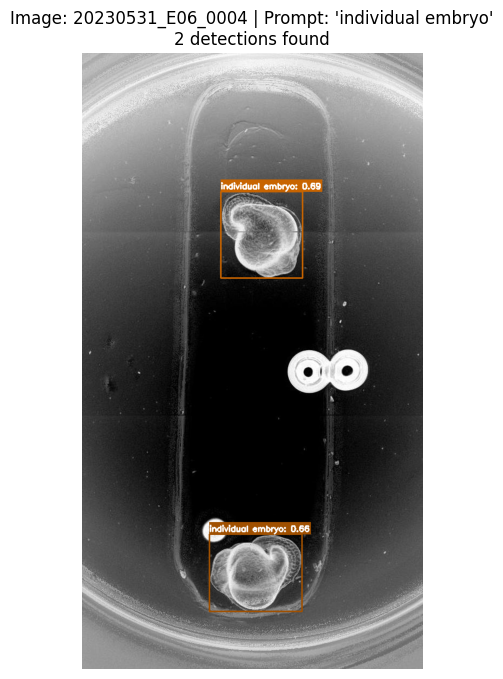

   🔍 [5/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.597


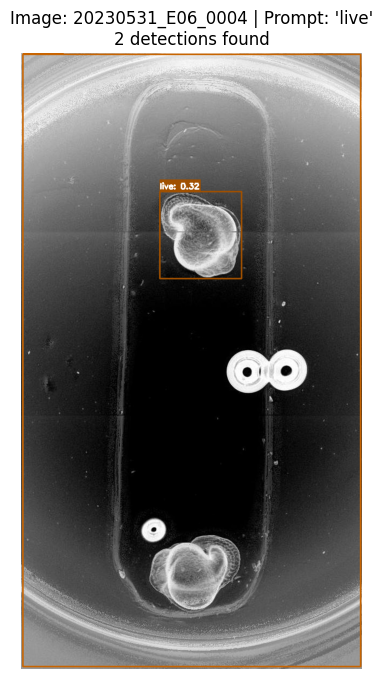

   🔍 [6/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.316


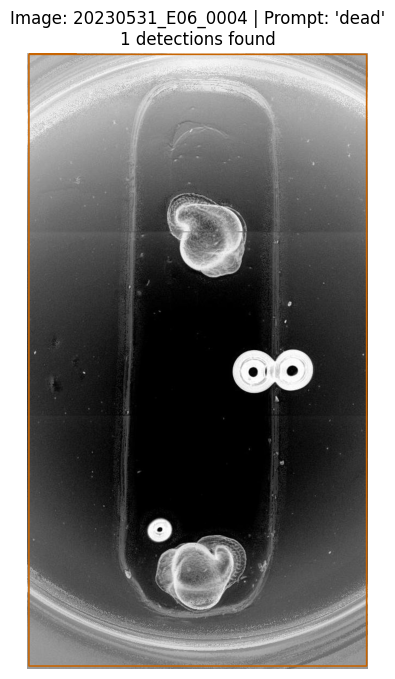


📸 Processing image [3/22]: 20230531_E06_0007
   🔍 [7/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.527


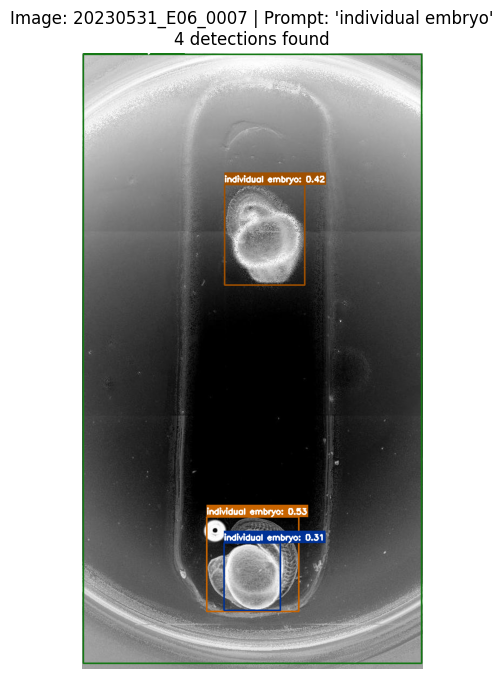

   🔍 [8/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.631


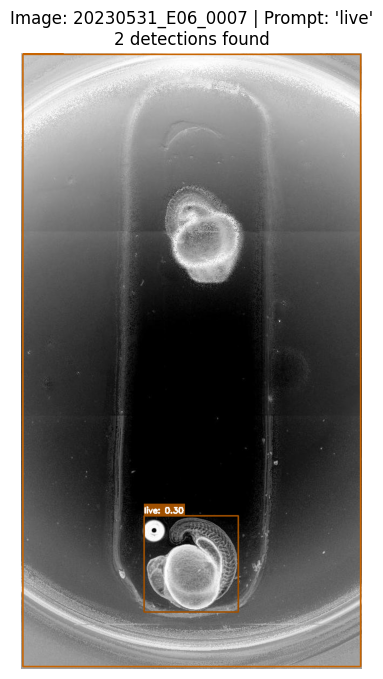

   🔍 [9/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.356


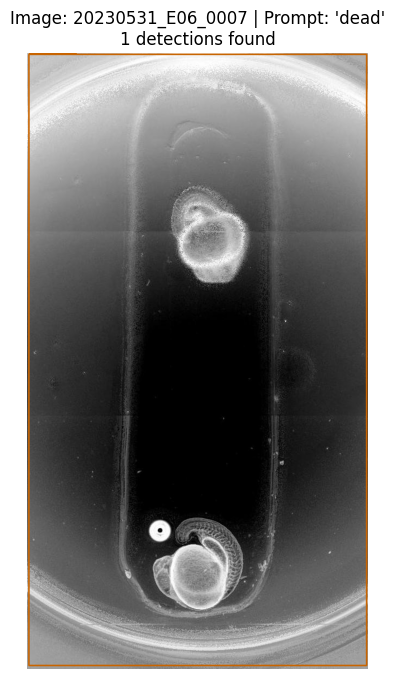


📸 Processing image [4/22]: 20230531_E06_0010
   🔍 [10/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.746


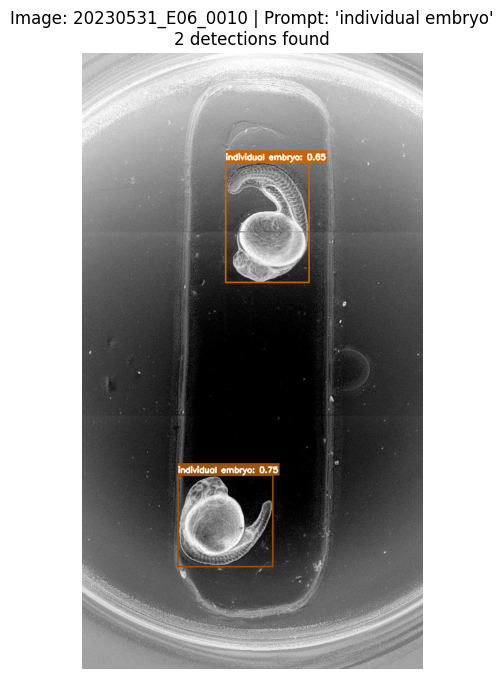

   🔍 [11/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.517


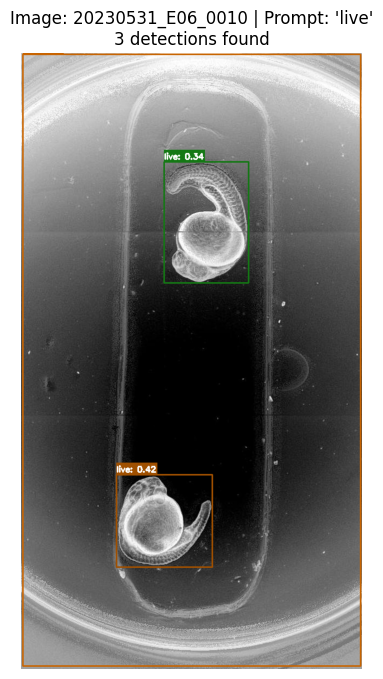

   🔍 [12/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.338


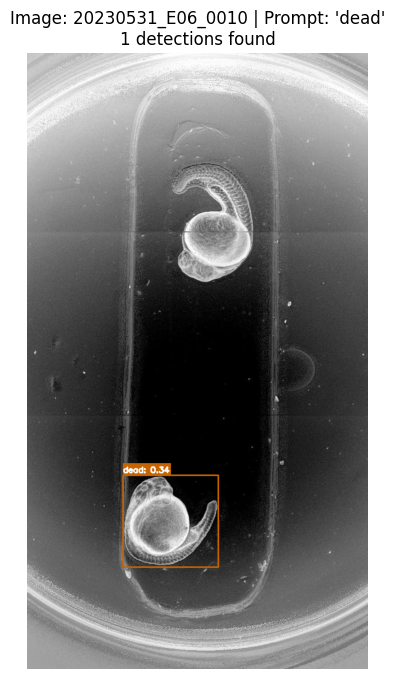


📸 Processing image [5/22]: 20230531_E06_0013
   🔍 [13/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.550


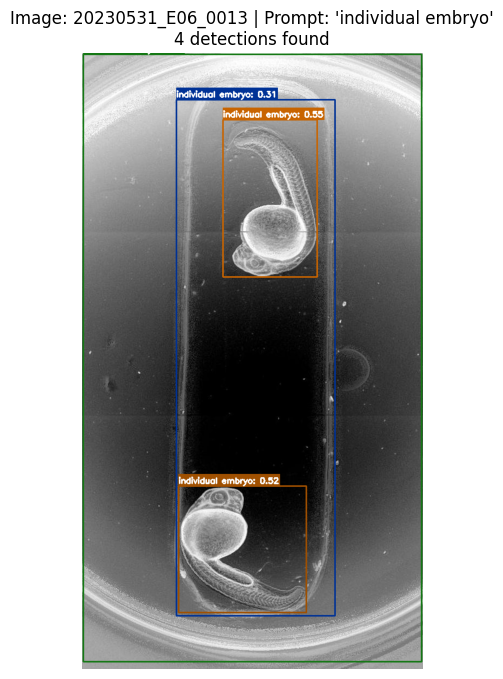

   🔍 [14/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.598


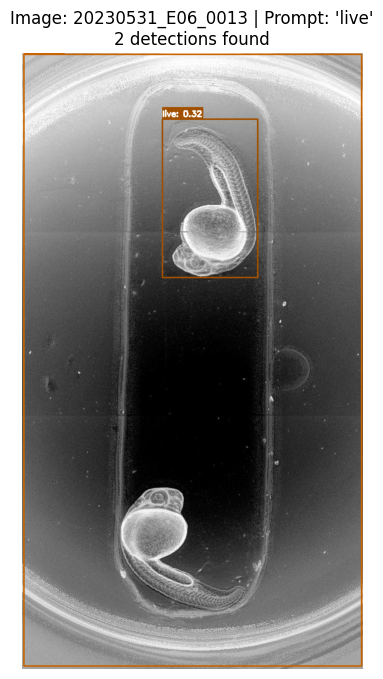

   🔍 [15/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.346


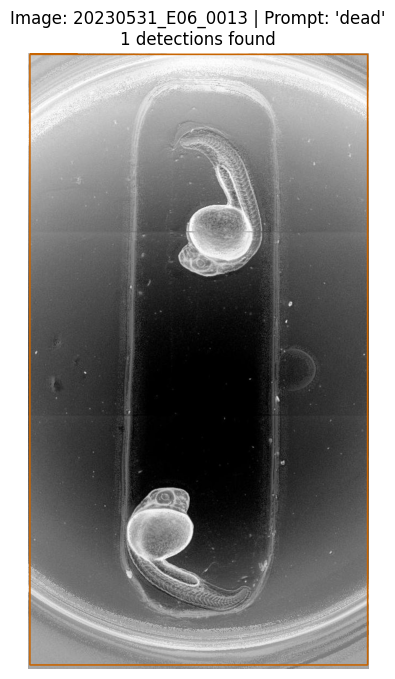


📸 Processing image [6/22]: 20230531_E06_0016
   🔍 [16/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.607


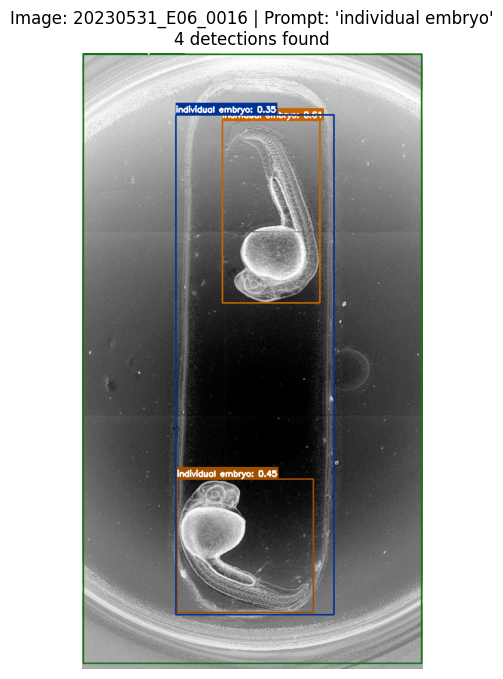

   🔍 [17/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.561


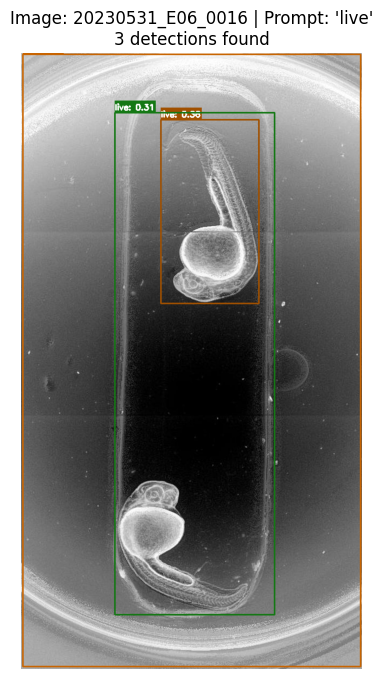

   🔍 [18/66] Running prompt: 'dead'
      📍 Found 2 detections
      🏆 Max confidence: 0.323


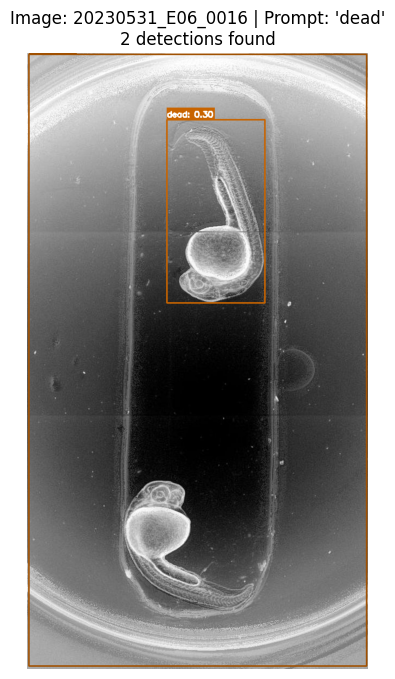


📸 Processing image [7/22]: 20230531_E06_0019
   🔍 [19/66] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.576


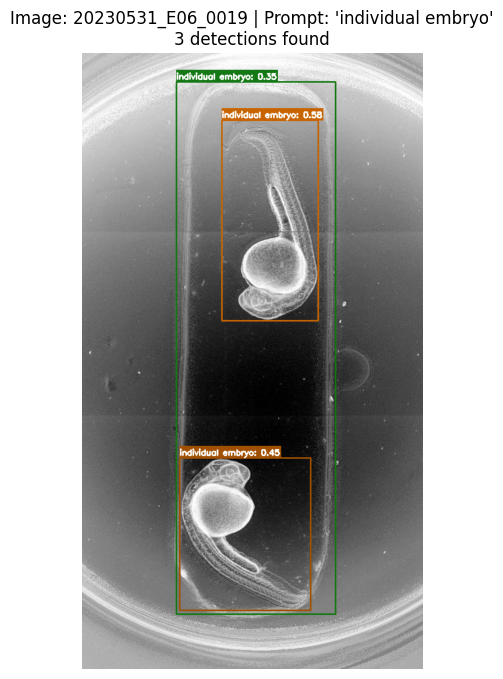

   🔍 [20/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.553


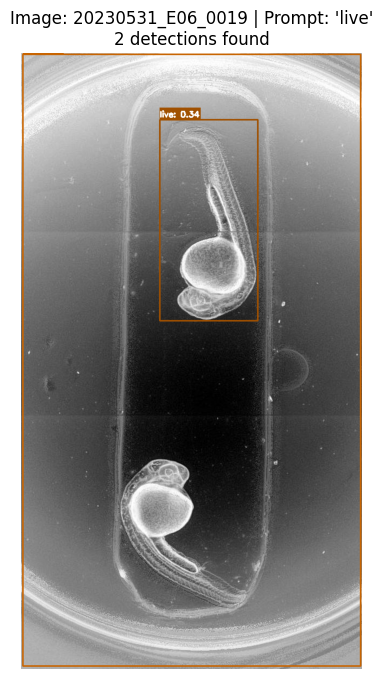

   🔍 [21/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.322


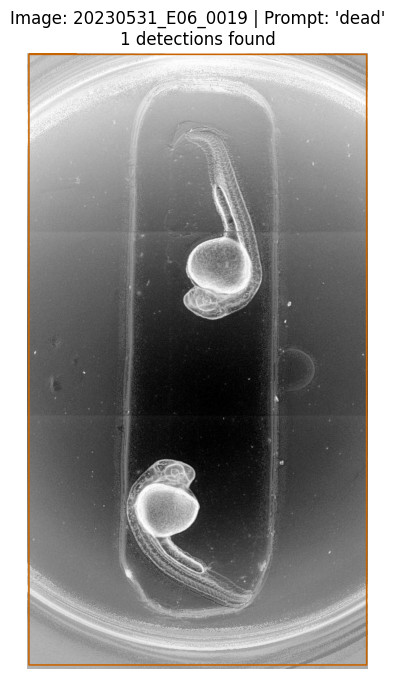


📸 Processing image [8/22]: 20230531_E06_0022
   🔍 [22/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.657


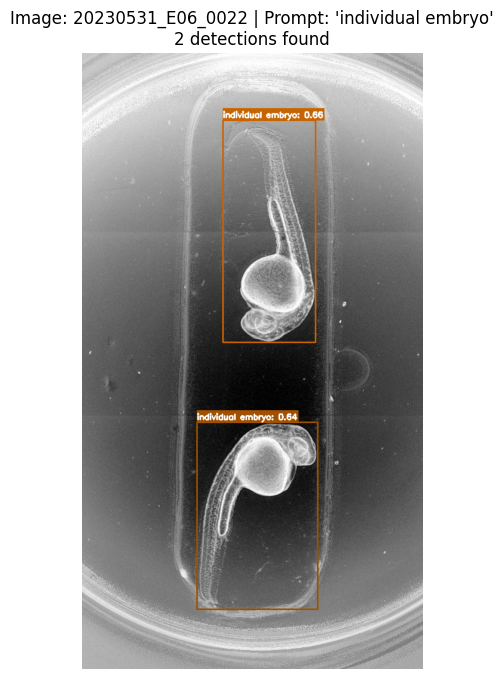

   🔍 [23/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.525


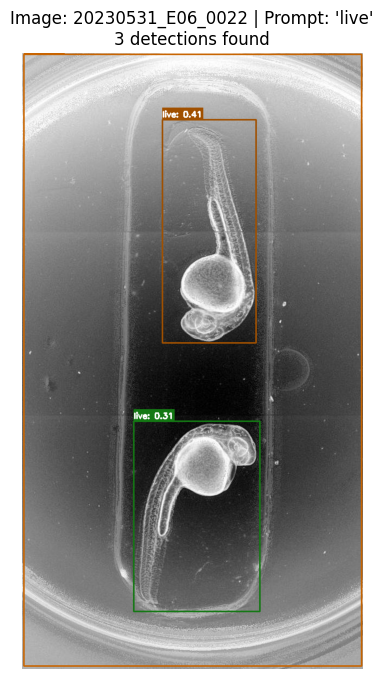

   🔍 [24/66] Running prompt: 'dead'
      📍 Found 2 detections
      🏆 Max confidence: 0.334


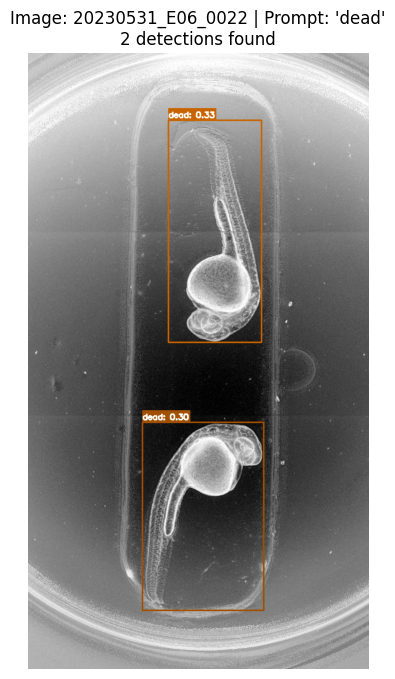


📸 Processing image [9/22]: 20230531_E06_0025
   🔍 [25/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.688


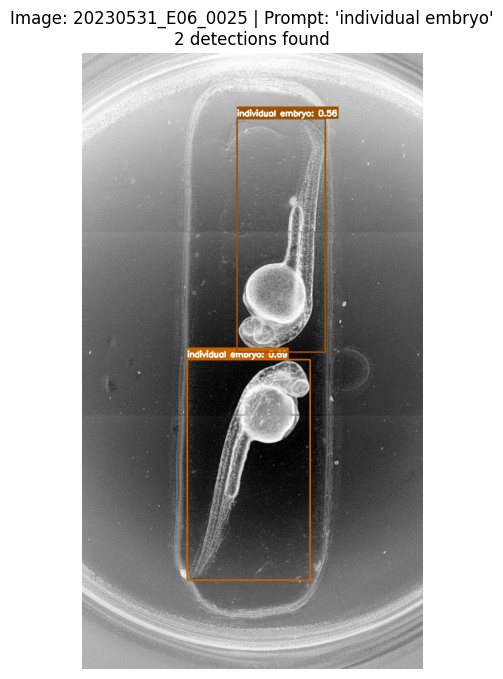

   🔍 [26/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.520


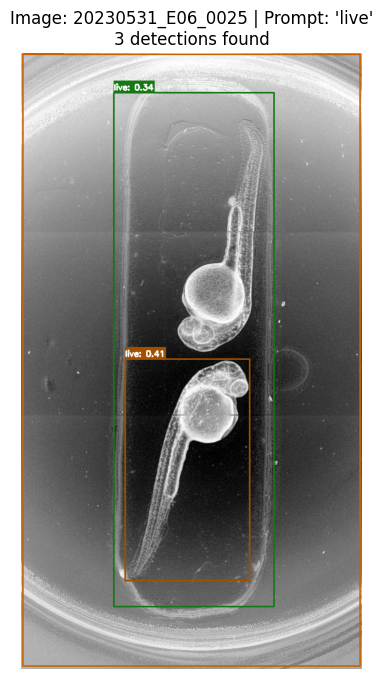

   🔍 [27/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.362


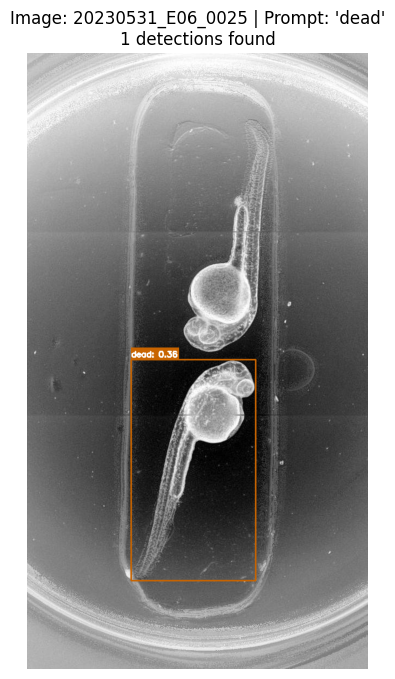


📸 Processing image [10/22]: 20230531_E06_0028
   🔍 [28/66] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.671


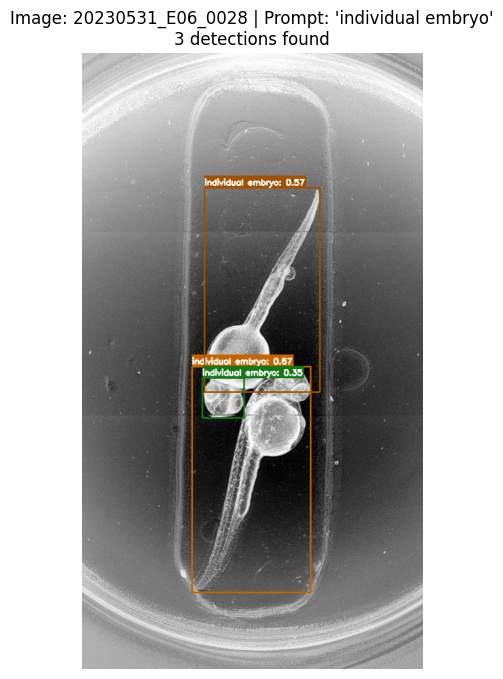

   🔍 [29/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.487


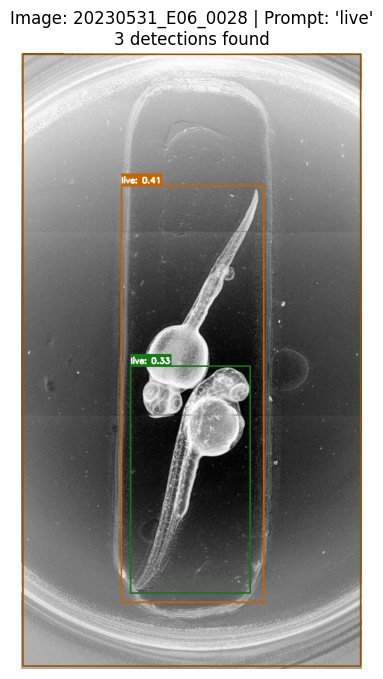

   🔍 [30/66] Running prompt: 'dead'
      📍 Found 0 detections


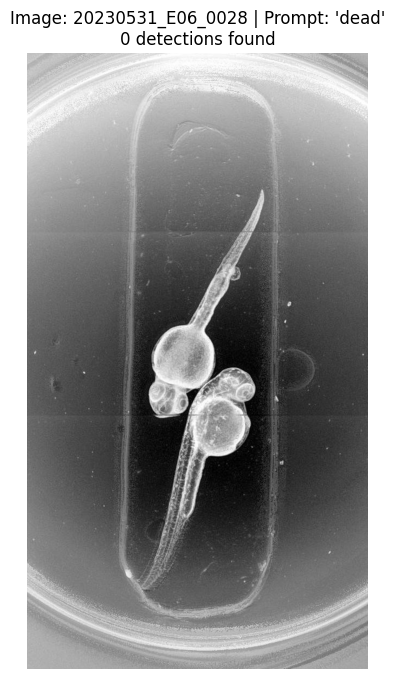


📸 Processing image [11/22]: 20230531_E06_0031
   🔍 [31/66] Running prompt: 'individual embryo'
      📍 Found 5 detections
      🏆 Max confidence: 0.501


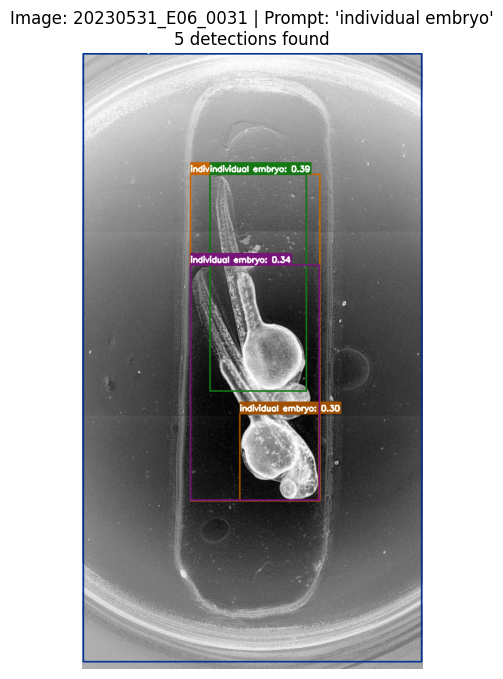

   🔍 [32/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.521


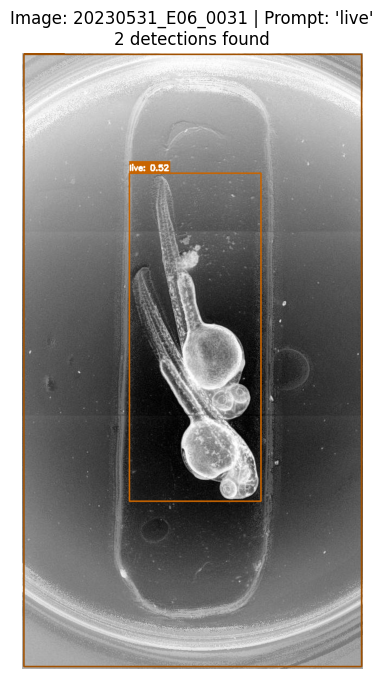

   🔍 [33/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.417


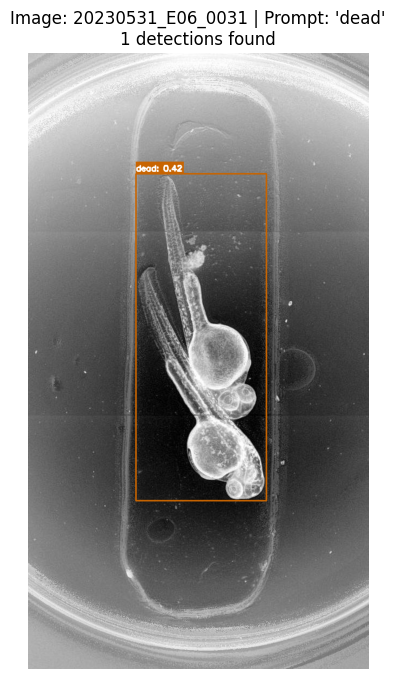


📸 Processing image [12/22]: 20230531_E06_0034
   🔍 [34/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.532


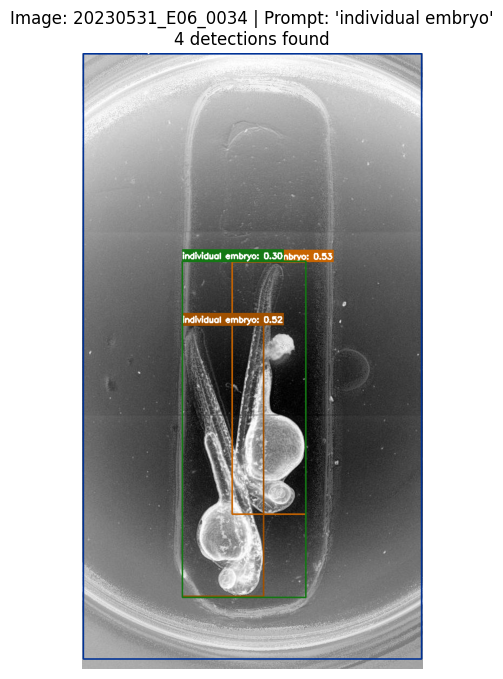

   🔍 [35/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.536


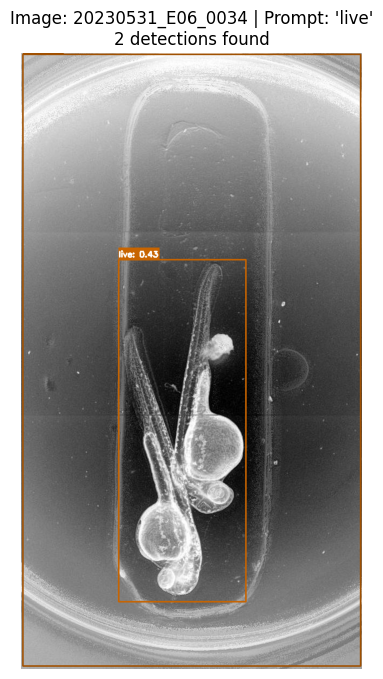

   🔍 [36/66] Running prompt: 'dead'
      📍 Found 2 detections
      🏆 Max confidence: 0.339


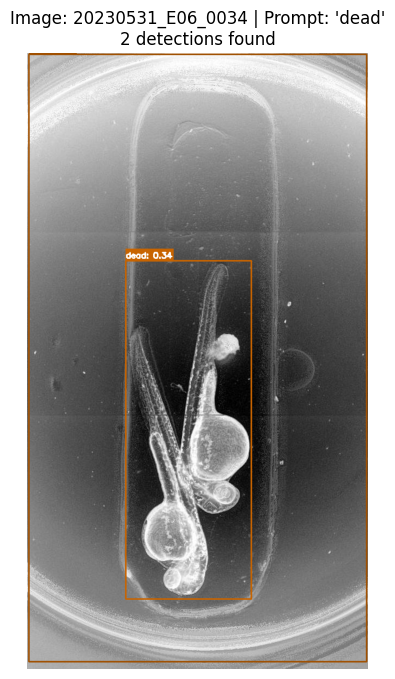


📸 Processing image [13/22]: 20230531_E06_0037
   🔍 [37/66] Running prompt: 'individual embryo'
      📍 Found 5 detections
      🏆 Max confidence: 0.499


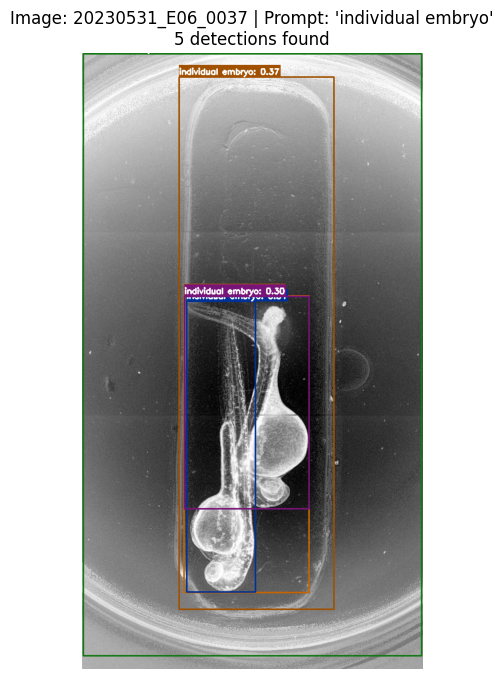

   🔍 [38/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.537


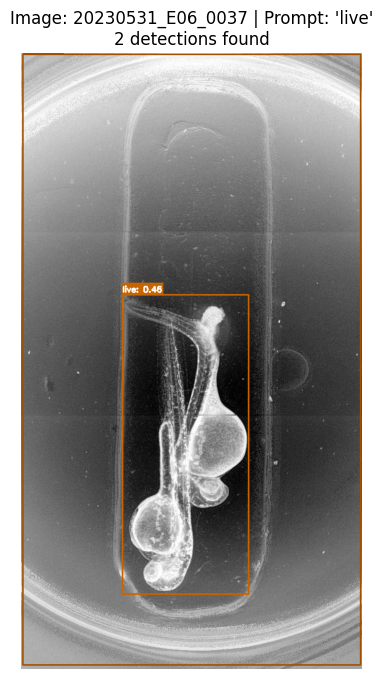

   🔍 [39/66] Running prompt: 'dead'
      📍 Found 2 detections
      🏆 Max confidence: 0.379


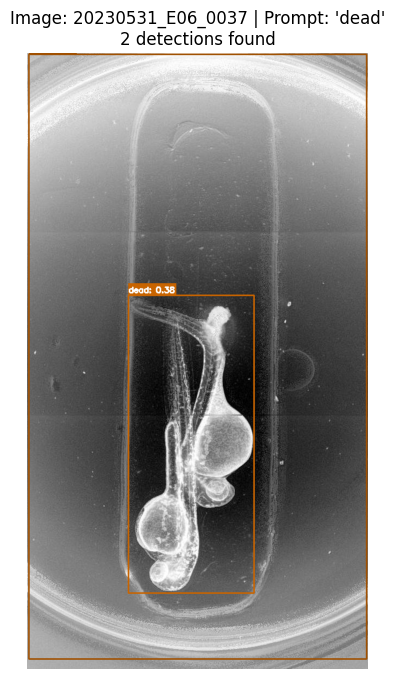


📸 Processing image [14/22]: 20230531_E06_0040
   🔍 [40/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.659


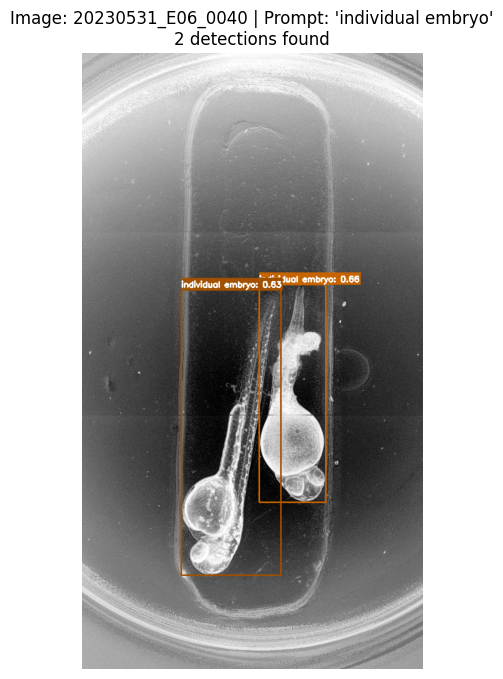

   🔍 [41/66] Running prompt: 'live'
      📍 Found 4 detections
      🏆 Max confidence: 0.531


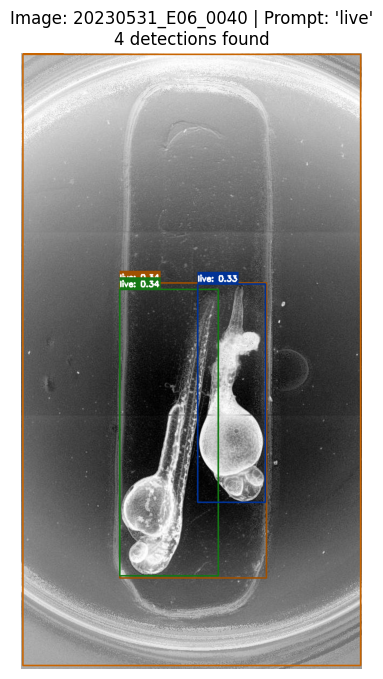

   🔍 [42/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.313


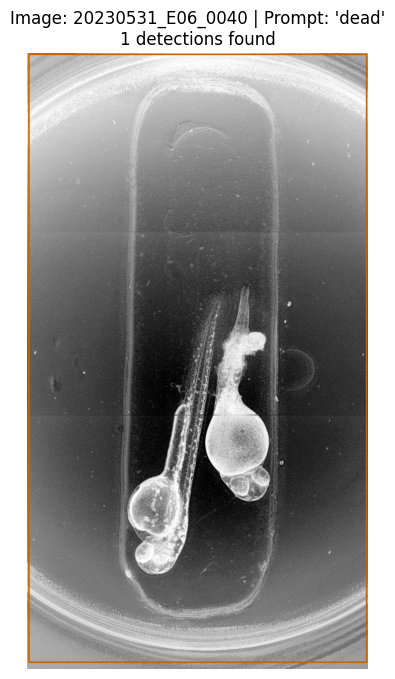


📸 Processing image [15/22]: 20230531_E06_0043
   🔍 [43/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.688


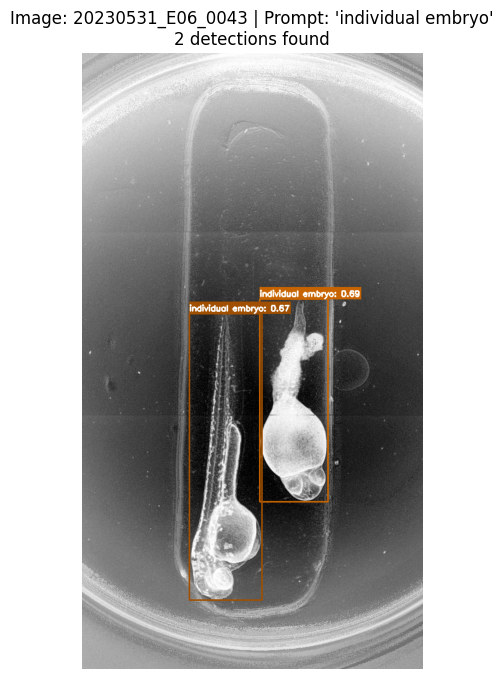

   🔍 [44/66] Running prompt: 'live'
      📍 Found 3 detections
      🏆 Max confidence: 0.527


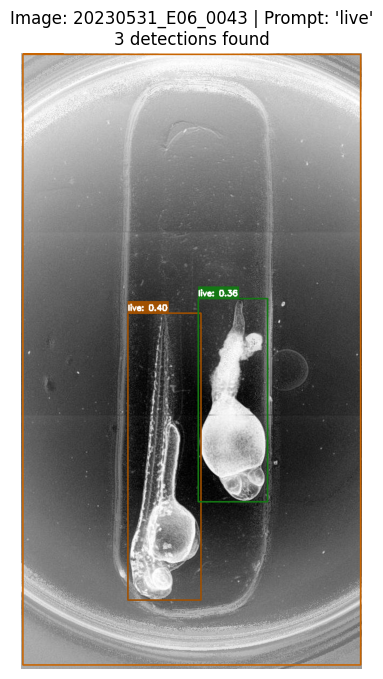

   🔍 [45/66] Running prompt: 'dead'
      📍 Found 2 detections
      🏆 Max confidence: 0.320


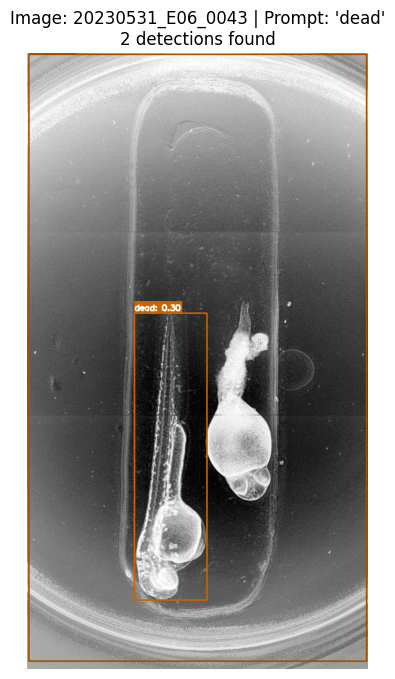


📸 Processing image [16/22]: 20230531_E06_0046
   🔍 [46/66] Running prompt: 'individual embryo'
      📍 Found 5 detections
      🏆 Max confidence: 0.466


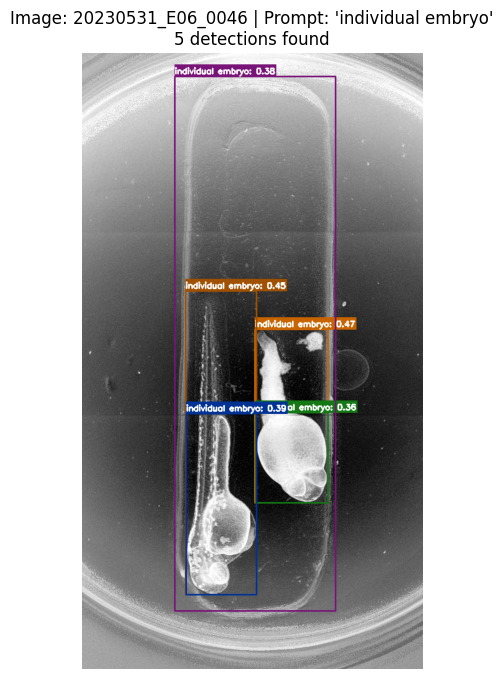

   🔍 [47/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.580


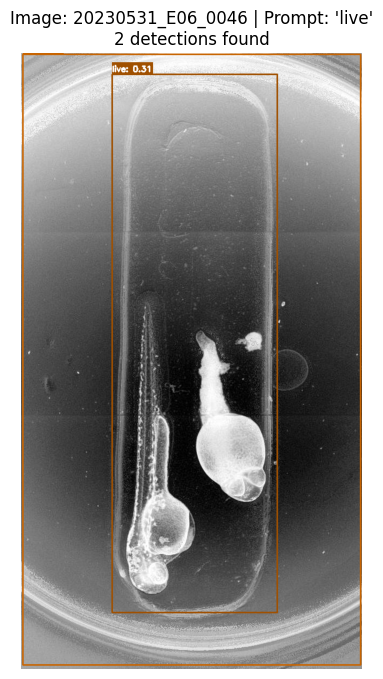

   🔍 [48/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.347


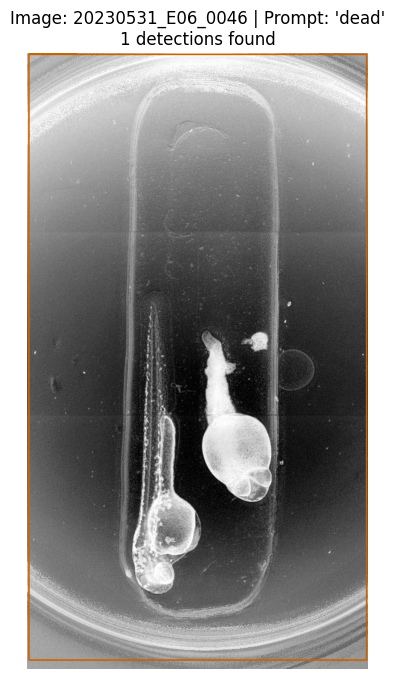


📸 Processing image [17/22]: 20230531_E06_0049
   🔍 [49/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.550


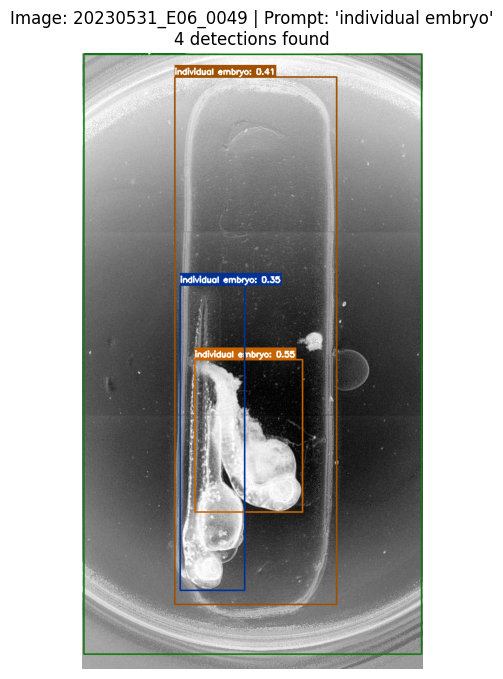

   🔍 [50/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.595


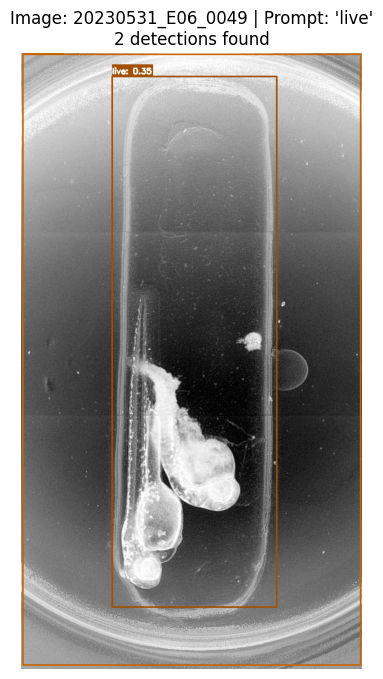

   🔍 [51/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.341


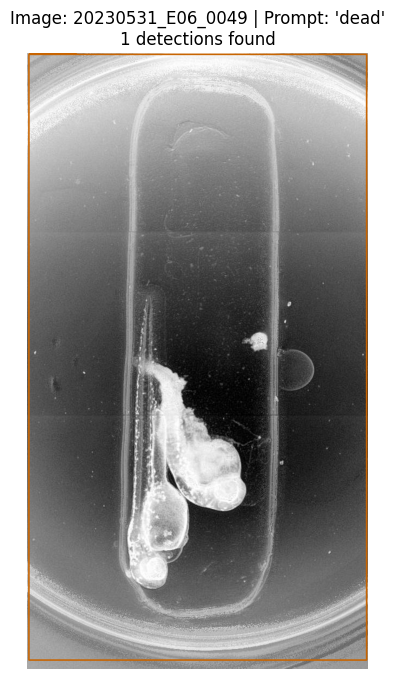


📸 Processing image [18/22]: 20230531_E06_0052
   🔍 [52/66] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.582


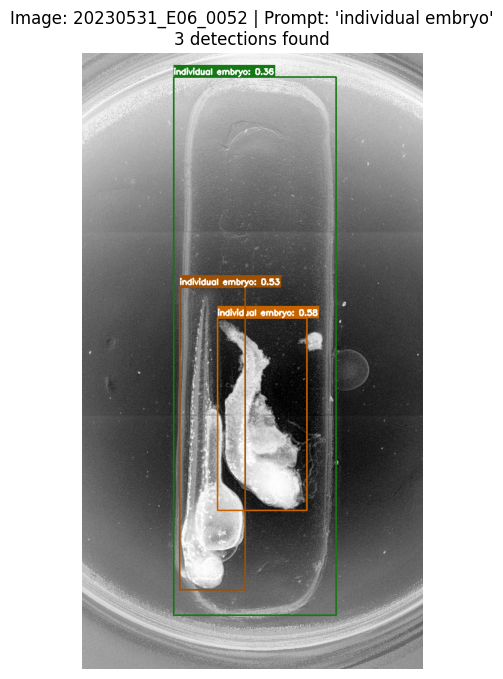

   🔍 [53/66] Running prompt: 'live'
      📍 Found 1 detections
      🏆 Max confidence: 0.540


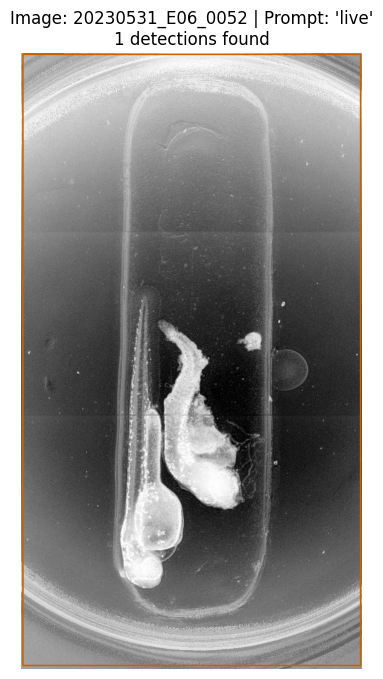

   🔍 [54/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.314


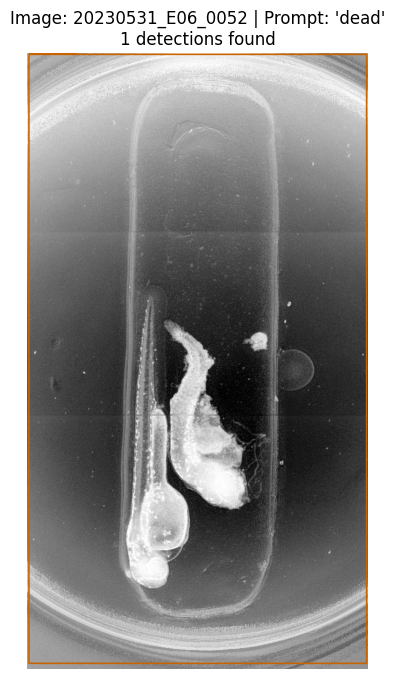


📸 Processing image [19/22]: 20230531_E06_0055
   🔍 [55/66] Running prompt: 'individual embryo'
      📍 Found 3 detections
      🏆 Max confidence: 0.618


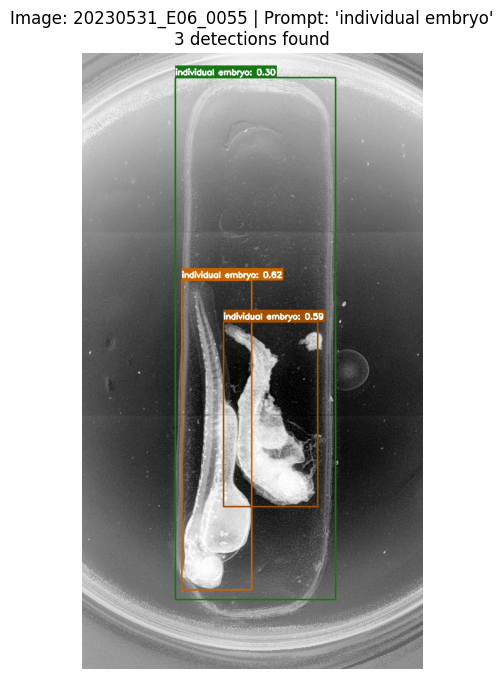

   🔍 [56/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.532


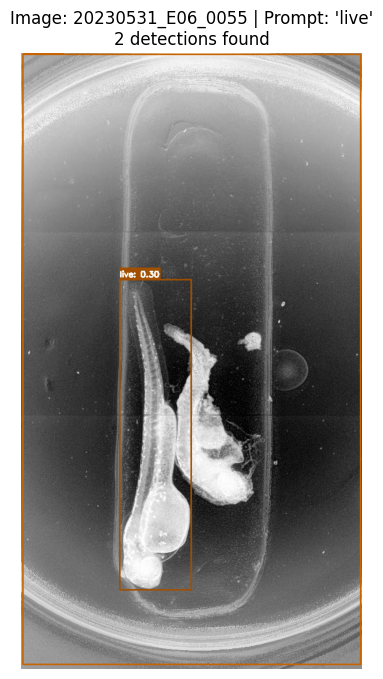

   🔍 [57/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.323


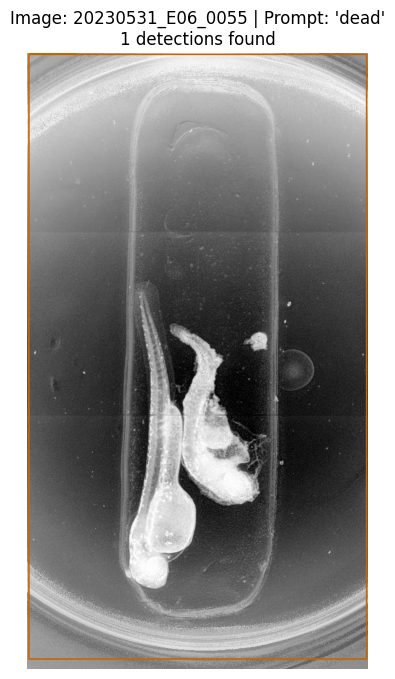


📸 Processing image [20/22]: 20230531_E06_0058
   🔍 [58/66] Running prompt: 'individual embryo'
      📍 Found 2 detections
      🏆 Max confidence: 0.640


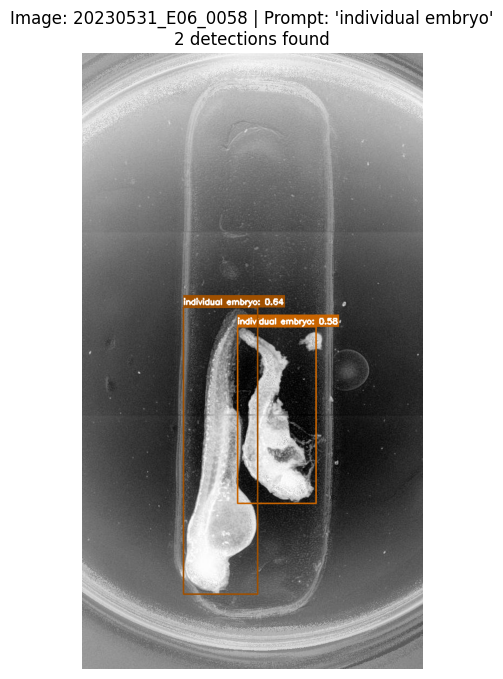

   🔍 [59/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.530


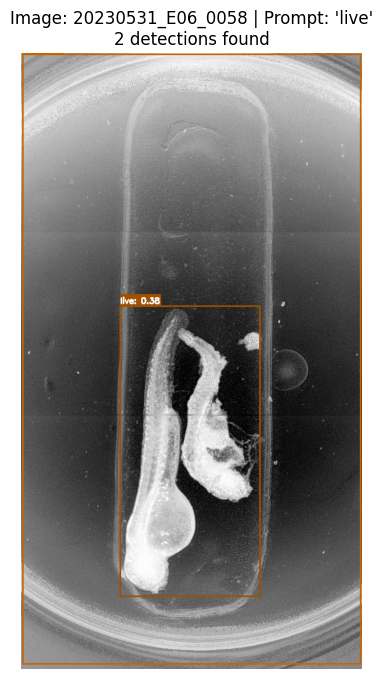

   🔍 [60/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.317


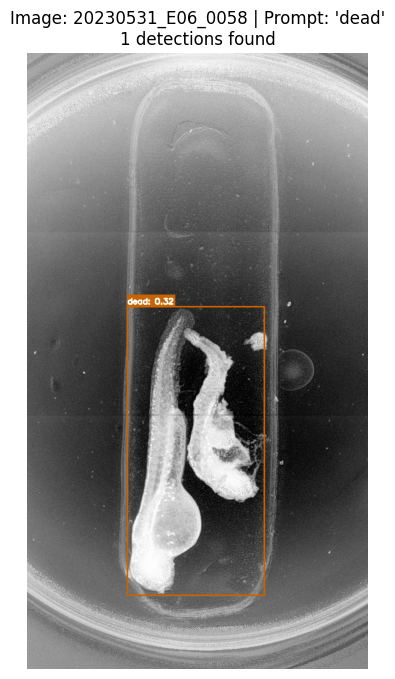


📸 Processing image [21/22]: 20230531_E06_0061
   🔍 [61/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.411


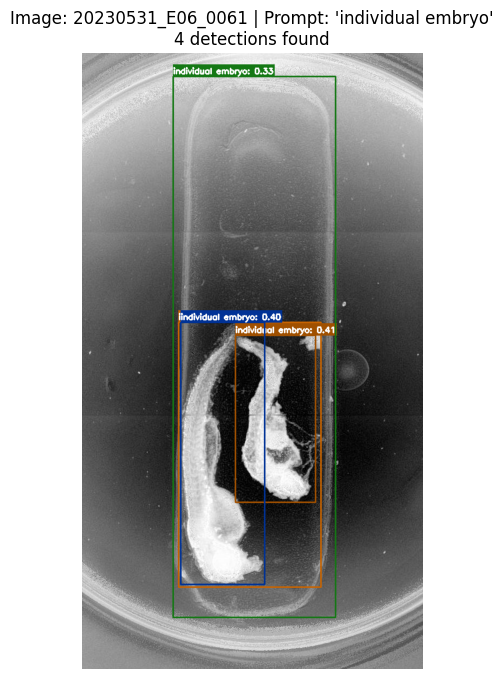

   🔍 [62/66] Running prompt: 'live'
      📍 Found 2 detections
      🏆 Max confidence: 0.513


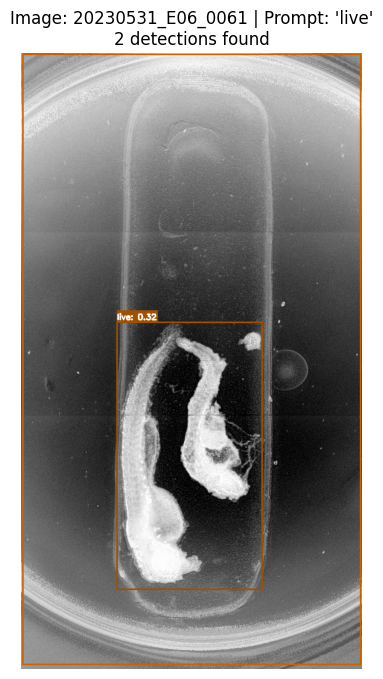

   🔍 [63/66] Running prompt: 'dead'
      📍 Found 1 detections
      🏆 Max confidence: 0.368


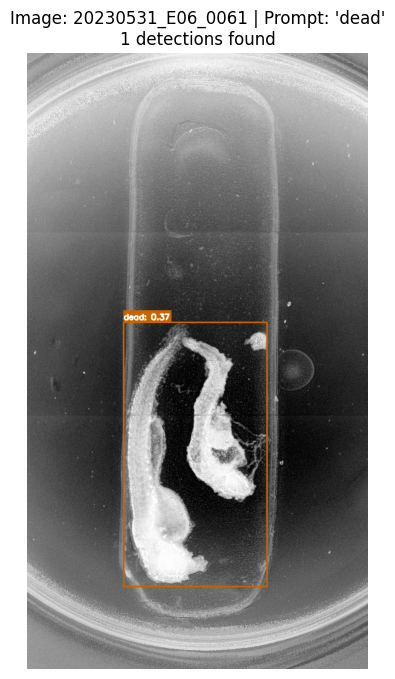


📸 Processing image [22/22]: 20230531_E06_0064
   🔍 [64/66] Running prompt: 'individual embryo'
      📍 Found 4 detections
      🏆 Max confidence: 0.437


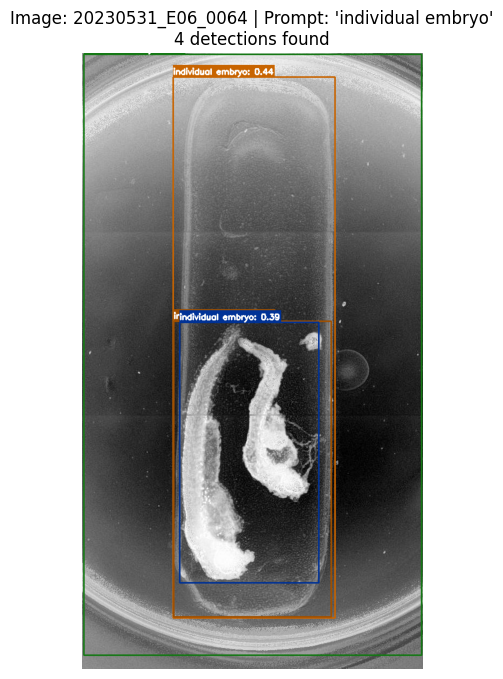

   🔍 [65/66] Running prompt: 'live'
      📍 Found 4 detections
      🏆 Max confidence: 0.543


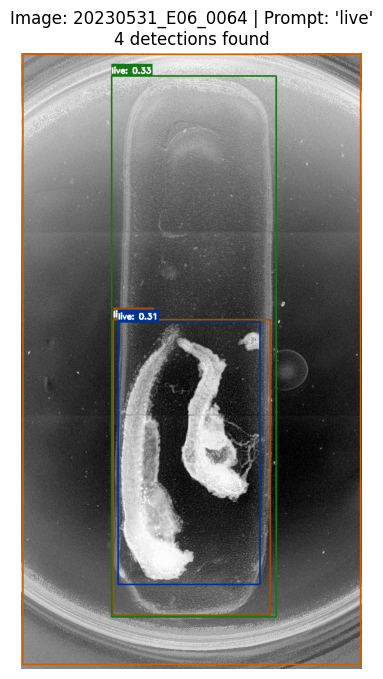

   🔍 [66/66] Running prompt: 'dead'
      📍 Found 2 detections
      🏆 Max confidence: 0.364


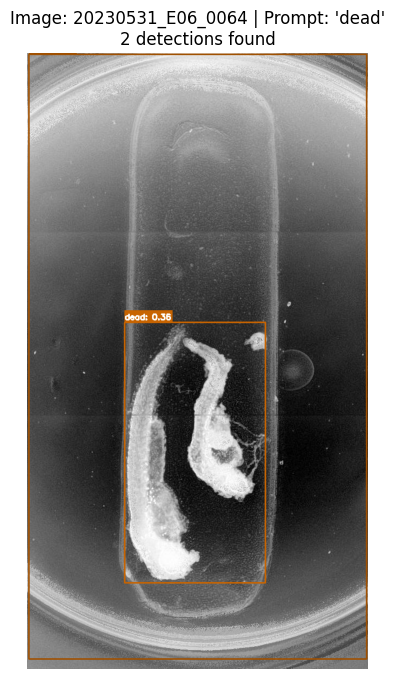


✅ Inference complete! 153 total detections


In [ ]:
# this confirms that the model finte tuned isnt very good at doing dead vs alive in complicated cases. 


prompt = ["individual embryo", "live", "dead"]

video_id = "20230531_E06"
metadata_path = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/segmentation_sandbox/data/raw_data_organized/experiment_metadata.json"

image_ids = list_image_ids_for_video(video_id, metadata_path)

img_paths = get_image_id_paths(image_ids, exper_metadata)

results = gdino_inference_with_visualization(
    model,
    img_paths[::3],  # Use every 3rd frame
    prompt,
    box_threshold=0.30, 
    text_threshold=0.1,
    show_anno=True,  # Set to False to only save images
    verbose=True,
    # save_dir=embroid_output_path,
    text_size=.25
)
